In [1]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
import datetime
import glob
import netCDF4
import xarray as xr
import pandas as pd
import seaborn as sns
plt.style.use('seaborn')

C:\Users\pkoll\AppData\Local\Temp\ipykernel_17512\4031092812.py:10: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [3]:
#### MIGHTI ####
L1m_fns = glob.glob('/disks/data/icon/Repository/Archive/LEVEL.1/MIGHTI-A/2020/002/Data/ICON_L1_MIGHTI-A_Science_2020-01-02_03????_v03r001.NC')
L1m_fns.sort()

#### FUV ####
L1f_fn = 'ICON_L1_FUV_SWP_2020-01-02_v05r001.NC'

#LOADING IN THE DATA
dsf_raw = xr.open_dataset(L1f_fn,engine = 'netcdf4')
dsf_raw


<xarray.Dataset>
Dimensions:                            (Epoch: 5745, Rows: 256, Stripes: 6)
Coordinates:
  * Epoch                              (Epoch) float64 1.578e+12 ... 1.578e+12
  * Rows                               (Rows) float32 0.0 1.0 ... 254.0 255.0
Dimensions without coordinates: Stripes
Data variables: (12/52)
    ICON_L1_FUVA_SWP_Start_Times       (Epoch) object ...
    ICON_L1_FUVA_SWP_Stop_Times        (Epoch) object ...
    ICON_L1_FUVA_SWP_Center_Times      (Epoch) object ...
    ICON_L1_FUVA_SWP_Integration_Time  (Epoch) float32 ...
    ICON_L1_FUVA_SWP_Chain_ID          (Epoch) float32 ...
    ICON_L1_FUVA_SWP_Quality_Flag      (Epoch) float32 ...
    ...                                 ...
    ICON_L1_FUVA_SWP_PROF_M3_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P0_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P3_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P6_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_GAIN_DAY          (Stripes) float32 ...
    ICON_L1_FUVA_SWP_GAIN_NIGHT        (Stripes) float32 ...
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       BKG/ICON_L1_FUV_Calibration-Background-SW_20...
    RAYLEIGH_CONVERSION:         [0.04132972 0.04132972 0.04132972 ... 0.0413...
    File_Date:                   Thu, 11 May 2023, 2023-05-11T20:23:20.071 UTC
    Generation_Date:             20230511
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

In [4]:
# Downselect the data to only include the variables we are concerned with.
dsf = dsf_raw[['ICON_L1_FUVA_SWP_Center_Times','ICON_L1_FUVA_SWP_PROF_P0']]  # IF STARS BECOME A PROBLEM, USE THE CLEAN VERSION
# Convert times to something Python and xarray can understand, and reindex the dataset by time instead of the obscure "Epoch"
t = pd.to_datetime(dsf.ICON_L1_FUVA_SWP_Center_Times.values)
dsf['time'] = (['Epoch'], t)
dsf = dsf.swap_dims({'Epoch':'time'})
dsf = dsf.rename({'Rows':'row'})
# Rename and drop useless variables
dsf['I_1356'] = dsf['ICON_L1_FUVA_SWP_PROF_P0']
dsf = dsf.drop(['ICON_L1_FUVA_SWP_PROF_P0','ICON_L1_FUVA_SWP_Center_Times','Epoch'])

In [5]:
L1f_fn_01 = 'ICON_L1_FUV_SWP_2020-01-01_v05r000.NC'
L1f_fn_02 = 'ICON_L1_FUV_SWP_2020-01-02_v05r001.NC'
L1f_fn_03 = 'ICON_L1_FUV_SWP_2020-01-03_v05r000.NC'
L1f_fn_04 = 'ICON_L1_FUV_SWP_2020-01-04_v05r000.NC'
L1f_fn_18 = 'ICON_L1_FUV_SWP_2020-01-18_v05r000.NC'

In [6]:
# Downselect the data to only include the variables we are concerned with.
# For now just use the 4th stripe (out of 6, labeled P0), and just use time and the calibrated brightness 

def data_opening(d):
    dsf_raw = xr.open_dataset(d,engine = 'netcdf4')
    dsf = dsf_raw[['ICON_L1_FUVA_SWP_Center_Times','ICON_L1_FUVA_SWP_PROF_P0']]
    # Convert times to something Python and xarray can understand, and reindex the dataset by time instead of the obscure "Epoch"
    t = pd.to_datetime(dsf.ICON_L1_FUVA_SWP_Center_Times.values)
    dsf['time'] = (['Epoch'], t)
    dsf = dsf.swap_dims({'Epoch':'time'})
    dsf = dsf.rename({'Rows':'row'})
    # Rename and drop useless variables
    dsf['I_1356'] = dsf['ICON_L1_FUVA_SWP_PROF_P0']
    dsf = dsf.drop(['ICON_L1_FUVA_SWP_PROF_P0','ICON_L1_FUVA_SWP_Center_Times','Epoch'])
    return dsf

In [7]:
df_01 = data_opening(L1f_fn_01)
df_02 = data_opening(L1f_fn_02)
df_03 = data_opening(L1f_fn_03)
df_04 = data_opening(L1f_fn_04)
df_18 = data_opening(L1f_fn_18)

In [8]:
# Trying Different Days on Different Seasons around the year: SPR
L1f_fn_322 = 'ICON_L1_FUV_SWP_2020-03-22_v05r000.NC'
L1f_fn_419 = 'ICON_L1_FUV_SWP_2020-04-19_v05r000.NC'
L1f_fn_510 = 'ICON_L1_FUV_SWP_2020-05-10_v05r000.NC'

df_322 = data_opening(L1f_fn_322)
df_419 = data_opening(L1f_fn_419)
df_510 = data_opening(L1f_fn_510)

In [9]:
def wave_peaks_tdf(df,r):
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Data')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 
    plt.show()
    
    from scipy.signal import find_peaks
    data = df.I_1356.isel(row = r)
    data_np = data.to_numpy()
    np.shape(data)
    
    max_data = max(data_np)
    time_diff = datetime.timedelta(minutes=19, hours=1) 

    
    indices = find_peaks(data, height = max_data * (4/6), distance = 100) 
    
    indexes = indices[0]
    #print(indexes)
    final_indexes = []
    
    for i in range(0,len(indexes)-1):
        if len(indexes) > 15:
            if indexes[i+1] - indexes[i] < 200:
                pass
            else:
                final_indexes.append(indexes[i])
        else:
            final_indexes.append(indexes[i])
    final_indexes.append(indexes[-1])
    #print(final_indexes)
    
    times_np = df_plt.time.to_numpy()
    
    times = []
    vals_at_times = []
    for i in final_indexes: 
        times.append(times_np[i])
        vals_at_times.append(data[i])
    #print(times,vals_at_times)
        
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Peaks')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 

    for i in range(0,len(times)):
        plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
    plt.show()

    

<IPython.core.display.Javascript object>


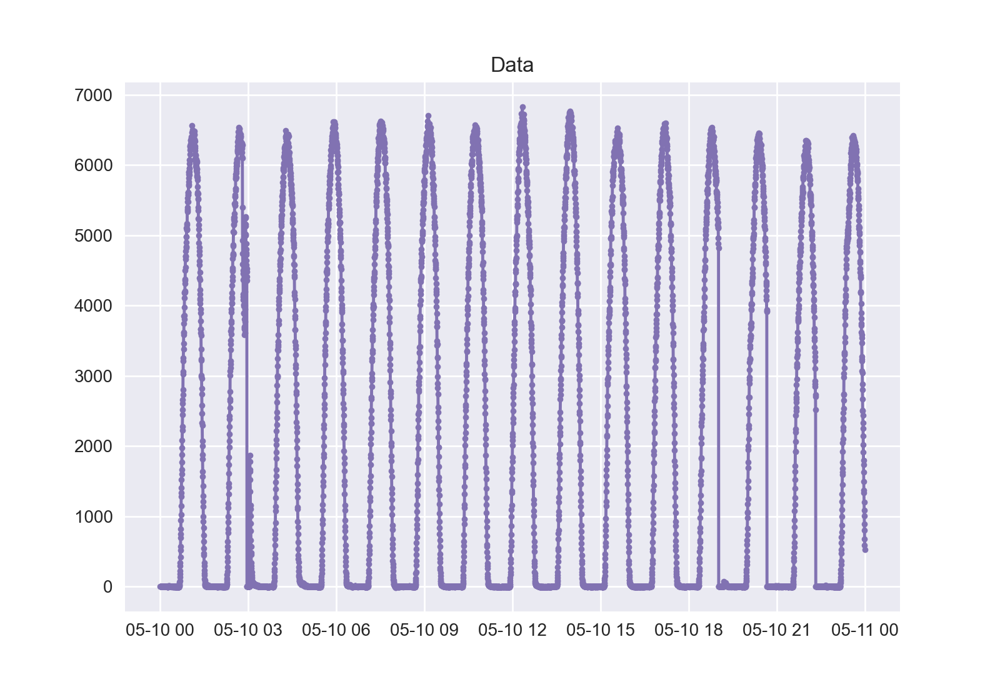

<IPython.core.display.Javascript object>


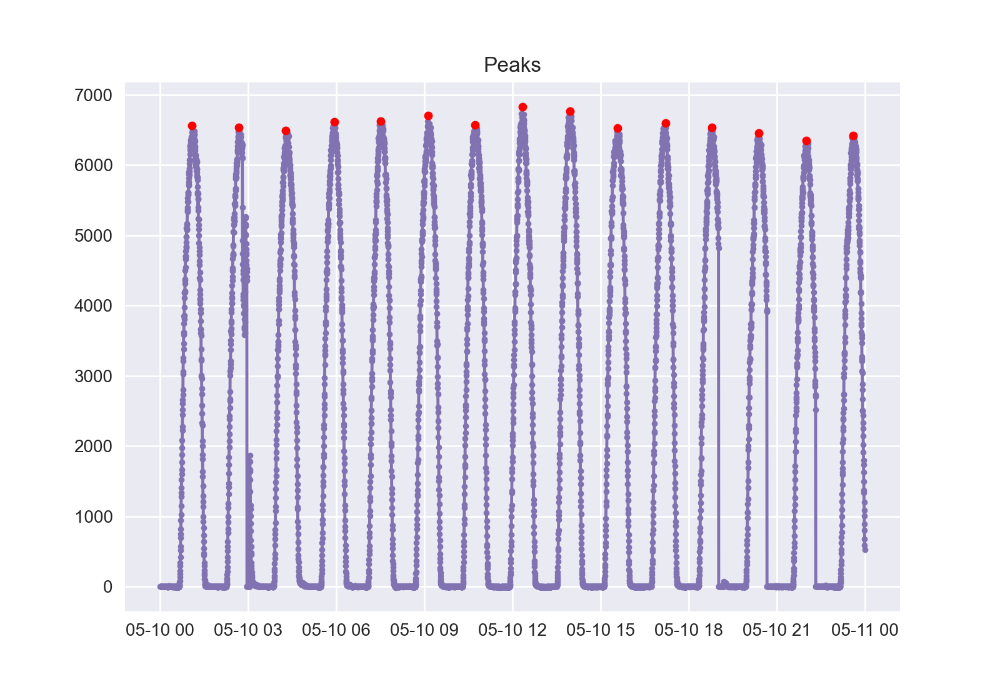

In [10]:
wave_peaks_tdf(df_510,148)

In [13]:
df = df_510
r = 148

from scipy.signal import find_peaks
data = df.I_1356.isel(row = r)
data_np = data.to_numpy()
np.shape(data)

max_data = max(data_np)
time_diff = pd.to_timedelta('75 m')
half_time_diff = pd.to_timedelta('50 m')

indices = find_peaks(data, height = max_data * (4/6)) 

indexes = indices[0]
indexes 

final_indexes = []

for i in range(0,len(indexes)-1):
    if len(indexes) > 15:
        if indexes[i+1] - indexes[i] < 200:
            pass
        else:
            final_indexes.append(indexes[i])
    else:
        final_indexes.append(indexes[i])
final_indexes.append(indexes[-1])
print(final_indexes)

[382, 858, 1322, 1786, 2268, 2734, 3210, 3672, 4148, 4619, 5087, 5554, 6026, 6495, 6964]


In [14]:
times_np = df.time.to_numpy()
times_dt = pd.to_datetime(times_np)
times_dt

DatetimeIndex(['2020-05-10 00:00:08.780000', '2020-05-10 00:00:21.085000',
               '2020-05-10 00:00:33.381000', '2020-05-10 00:00:45.684000',
               '2020-05-10 00:00:57.980000', '2020-05-10 00:01:10.285000',
               '2020-05-10 00:01:22.581000', '2020-05-10 00:01:34.884000',
               '2020-05-10 00:01:47.180000', '2020-05-10 00:01:59.484000',
               ...
               '2020-05-10 23:58:01.279000', '2020-05-10 23:58:13.582000',
               '2020-05-10 23:58:25.878000', '2020-05-10 23:58:38.183000',
               '2020-05-10 23:58:50.479000', '2020-05-10 23:59:02.782000',
               '2020-05-10 23:59:15.078000', '2020-05-10 23:59:27.381000',
               '2020-05-10 23:59:39.677000', '2020-05-10 23:59:51.982000'],
              dtype='datetime64[ns]', length=7012, freq=None)

In [15]:
# Getting timeslice for to each peak
all_orbits = []
for i in final_indexes:
    start_time = times_dt[i] - half_time_diff
    end_time = start_time + time_diff
    df_orbit = df.sel(time=slice(start_time, end_time))
    all_orbits.append(df_orbit)
        
len(all_orbits)

15

In [11]:
def orbits_finder(df):
    r = 148
    from scipy.signal import find_peaks
    data = df.I_1356.isel(row = r)
    data_np = data.to_numpy()
    np.shape(data)

    max_data = max(data_np)
    time_diff = pd.to_timedelta('75 m')
    half_time_diff = pd.to_timedelta('50 m')

    indices = find_peaks(data, height = max_data * (4/6)) 

    indexes = indices[0]
    indexes 

    final_indexes = []

    for i in range(0,len(indexes)-1):
        if len(indexes) > 15:
            if indexes[i+1] - indexes[i] < 200:
                pass
            else:
                final_indexes.append(indexes[i])
        else:
            final_indexes.append(indexes[i])
    final_indexes.append(indexes[-1])
    
    times_np = df.time.to_numpy()
    times_dt = pd.to_datetime(times_np)
    
    all_orbits = []
    for i in final_indexes:
        start_time = times_dt[i] - half_time_diff
        end_time = start_time + time_diff
        df_orbit = df.sel(time=slice(start_time, end_time))
        all_orbits.append(df_orbit)
        
    return all_orbits

<IPython.core.display.Javascript object>


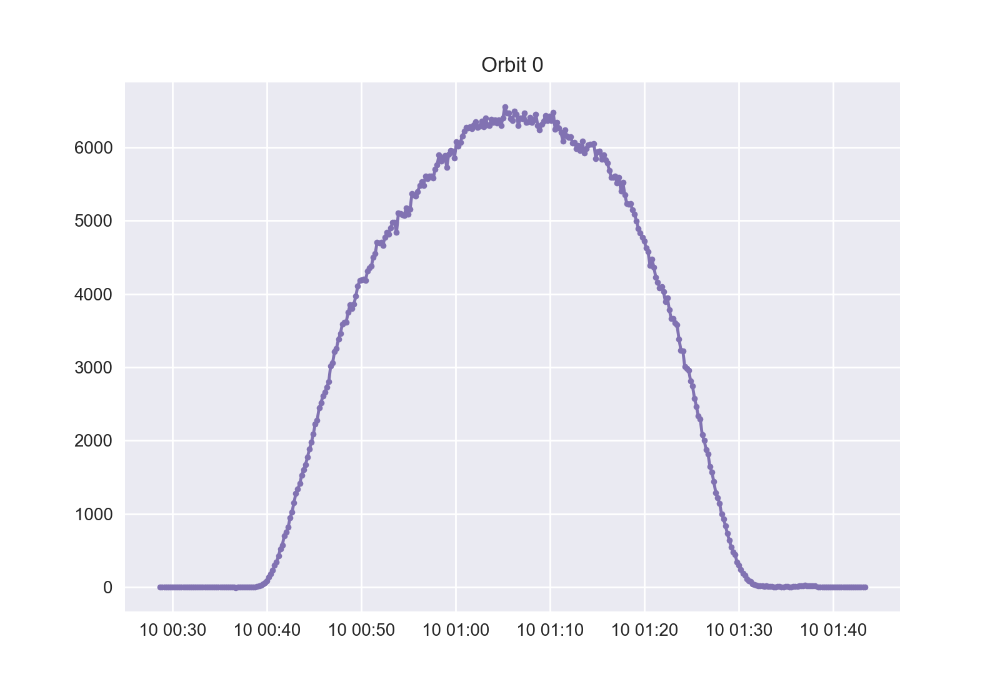

In [17]:
# Selecting a specific row and plotting first orbit
orb_0 = all_orbits[0].isel(row = 148)

plt.figure()
plt.title('Orbit 0')
plt.plot(orb_0.time, orb_0.I_1356, 'C3.-') 
plt.show()

<IPython.core.display.Javascript object>


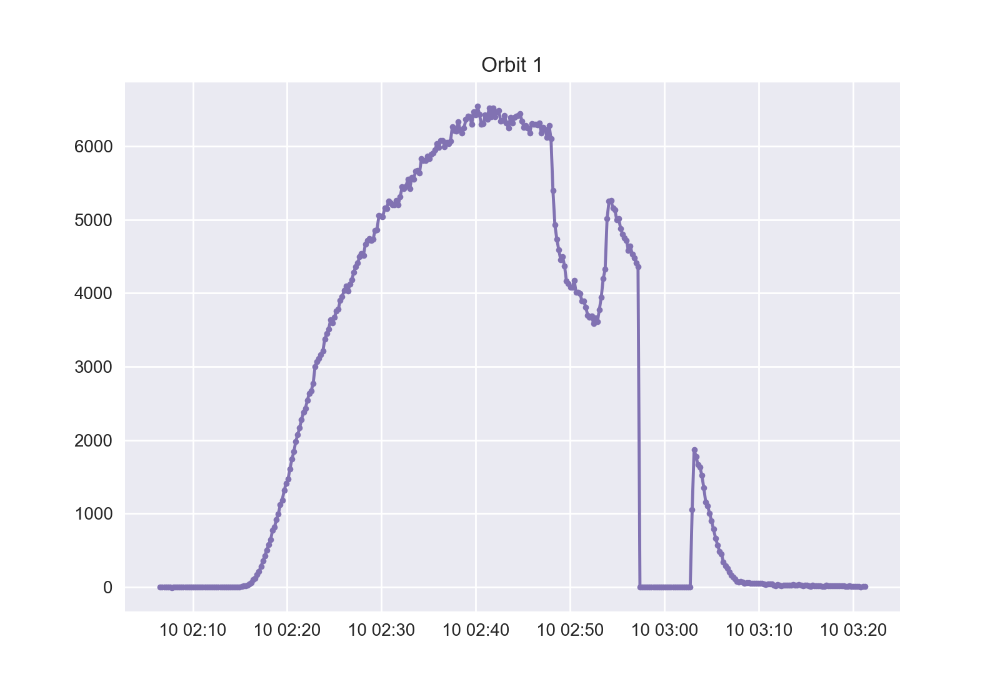

In [20]:
# Selecting a specific row and plotting first orbit

# CONJUGATE MANEUVER (Instrument moved and then turned off when it faced the Sun)
orb_1 = all_orbits[1].isel(row = 148)

plt.figure()
plt.title('Orbit 1')
plt.plot(orb_1.time, orb_1.I_1356, 'C3.-') 
plt.show()

In [12]:
def single_orb_plotter(orbit_arr,n):
    orb = orbit_arr[n].isel(row = 148)
    plt_title = 'Orbit ' + str(n)
    
    plt.figure()
    plt.title(plt_title)
    plt.plot(orb.time, orb.I_1356, 'C3.-') 
    plt.show()
        

In [13]:
def single_orb(orbit_arr,n):
    orb = orbit_arr[n].isel(row = 148)
    t = orb.time
    val = orb.I_1356
    return(t, val)

<IPython.core.display.Javascript object>


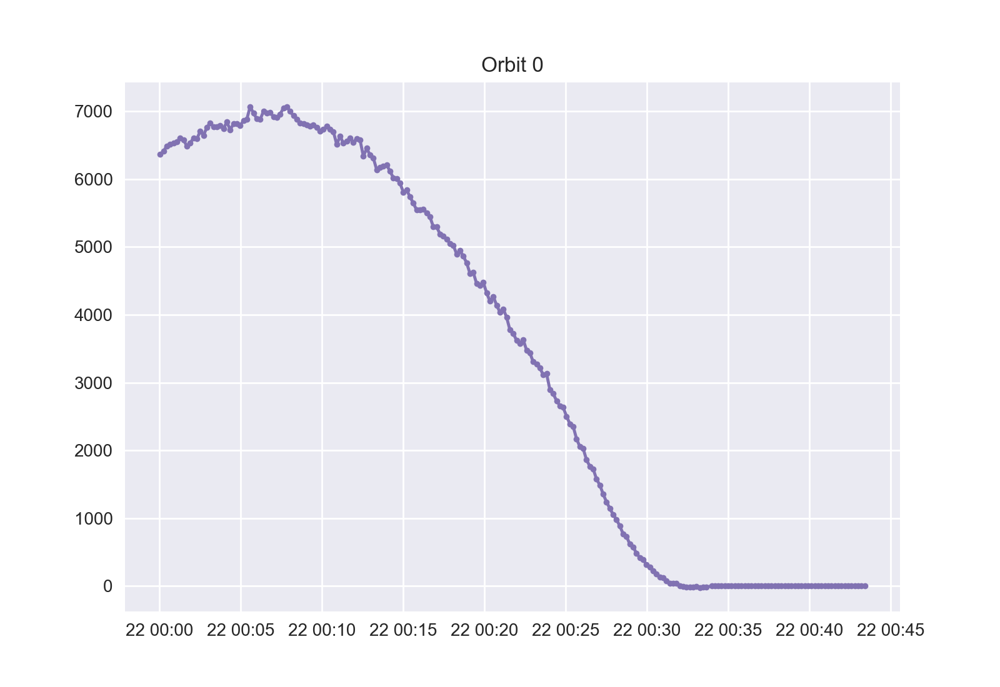

<xarray.DataArray 'I_1356' (time: 212)>
array([ 6.365116e+03,  6.413459e+03,  6.491240e+03, ..., -1.517197e-02,
       -1.426381e-02, -1.343934e-02], dtype=float32)
Coordinates:
    row      float32 148.0
  * time     (time) datetime64[ns] 2020-03-22T00:00:02.578000 ... 2020-03-22T...
Attributes: (12/19)
    TYPE:          float (4-bytes)
    CATDESC:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    CONTENT:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    DEPEND_0:      Epoch
    DEPEND_1:      Rows
    DISPLAY_TYPE:  spectrogram
    ...            ...
    VAR_TYPE:      data
    SCALETYP:      linear
    VAR_NOTES:     Vertical profile for 0 to +3 degrees FOV
    Valid_Min:     -1000000.0
    Valid_Max:     1000000.0
    Time_Base:     FIXED: 1970-01-01 UTC

In [69]:
single_orb_plotter(all_orbits,0)[1]

<IPython.core.display.Javascript object>


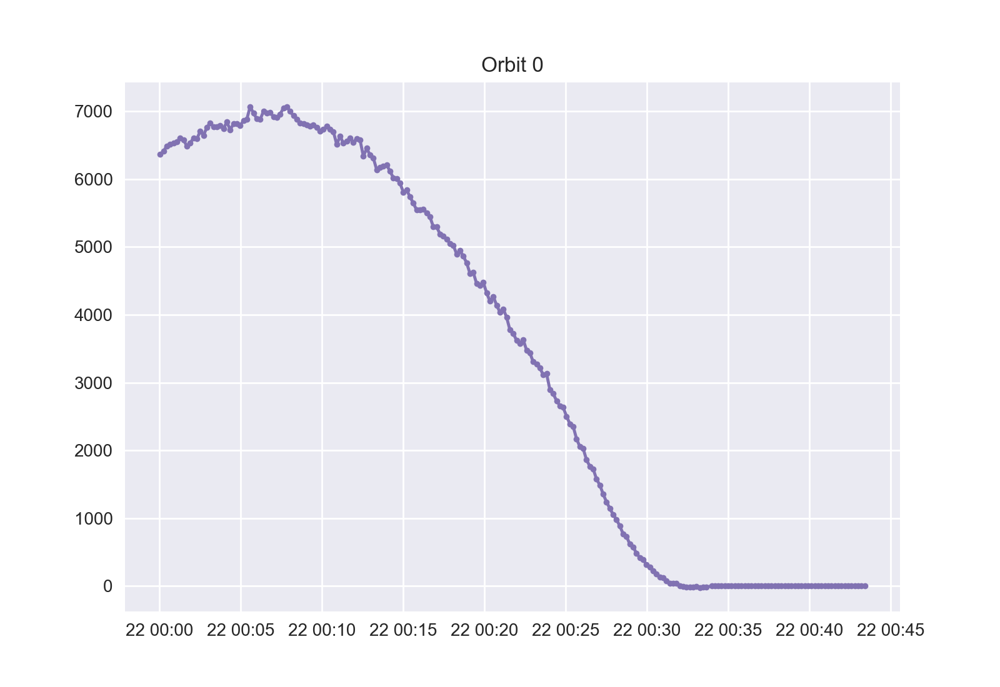

<xarray.DataArray 'I_1356' (time: 212)>
array([ 6.365116e+03,  6.413459e+03,  6.491240e+03, ..., -1.517197e-02,
       -1.426381e-02, -1.343934e-02], dtype=float32)
Coordinates:
    row      float32 148.0
  * time     (time) datetime64[ns] 2020-03-22T00:00:02.578000 ... 2020-03-22T...
Attributes: (12/19)
    TYPE:          float (4-bytes)
    CATDESC:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    CONTENT:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    DEPEND_0:      Epoch
    DEPEND_1:      Rows
    DISPLAY_TYPE:  spectrogram
    ...            ...
    VAR_TYPE:      data
    SCALETYP:      linear
    VAR_NOTES:     Vertical profile for 0 to +3 degrees FOV
    Valid_Min:     -1000000.0
    Valid_Max:     1000000.0
    Time_Base:     FIXED: 1970-01-01 UTC

In [65]:
single_orb_plotter(all_orbits,0)

<IPython.core.display.Javascript object>


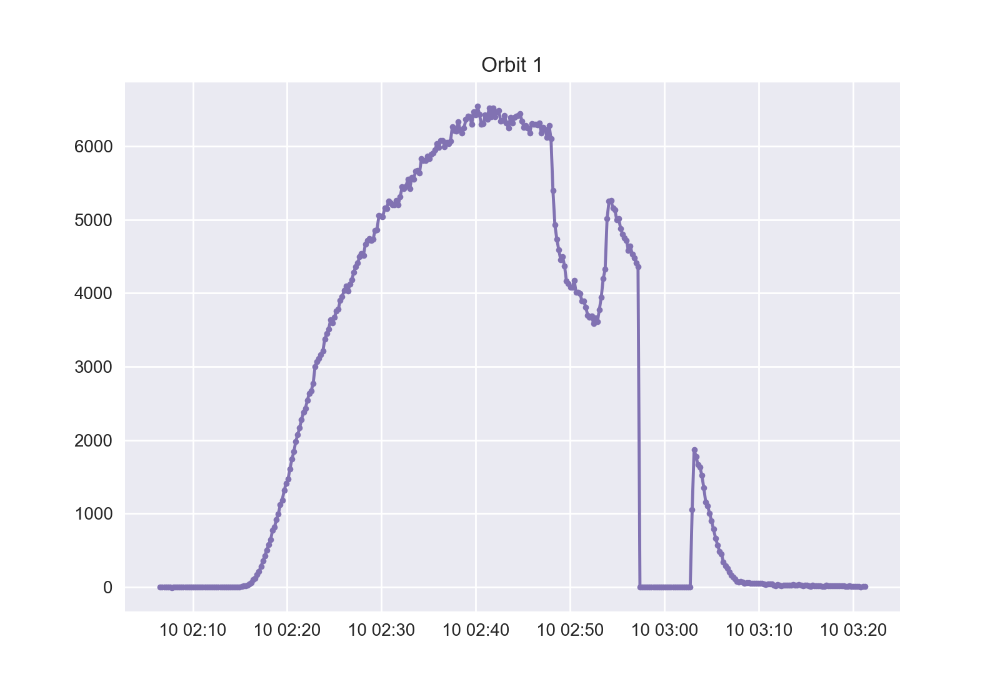

In [22]:
single_orb_plotter(all_orbits,1)

#### Trying this on a different day!

<IPython.core.display.Javascript object>


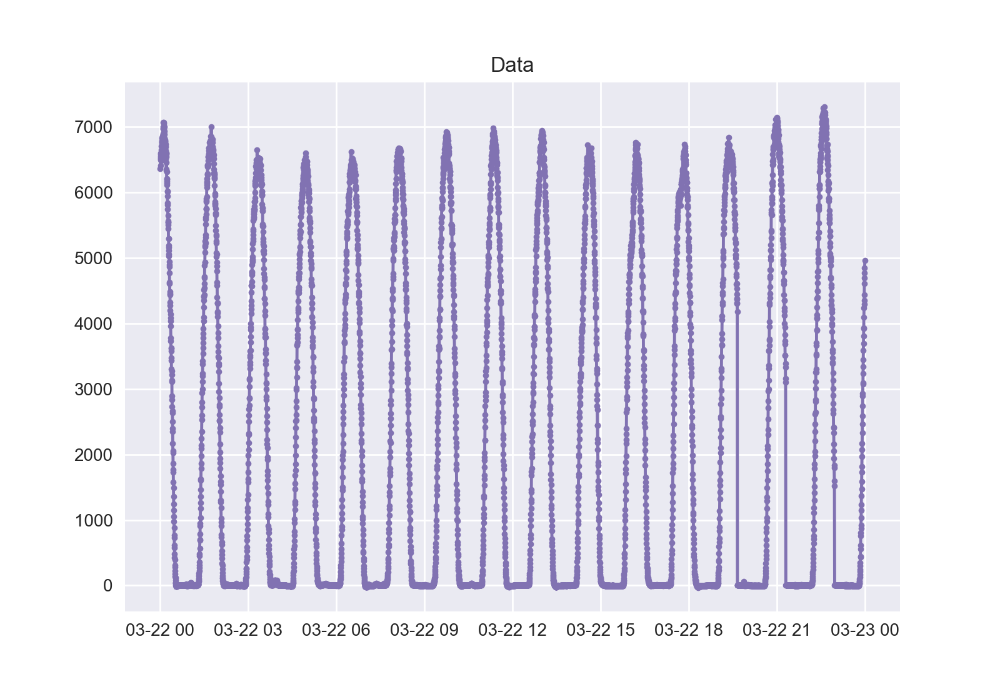

<IPython.core.display.Javascript object>


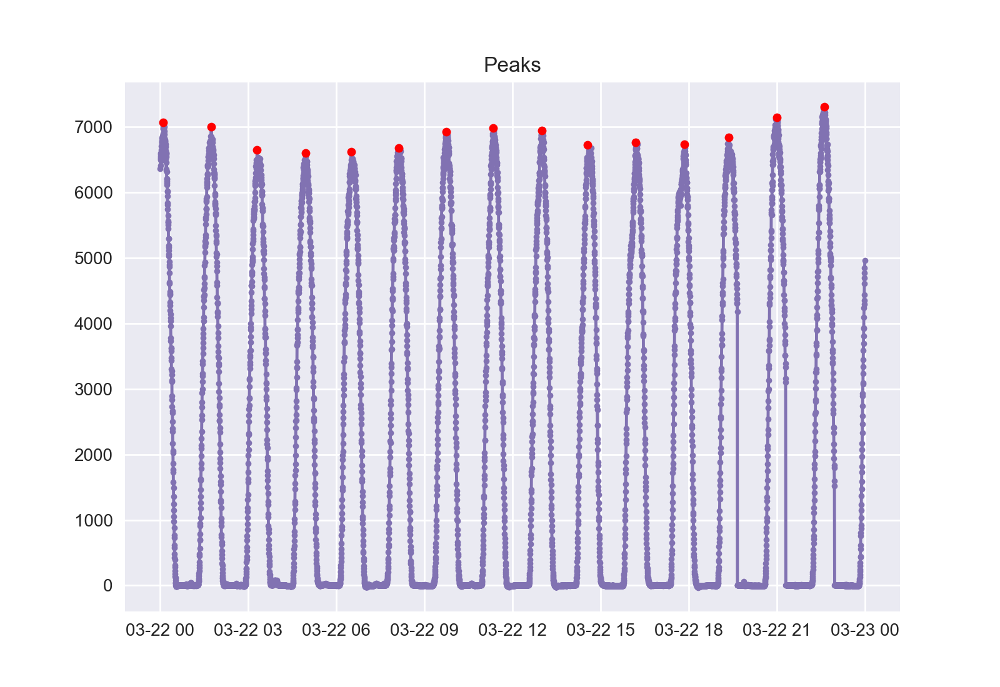

In [23]:
wave_peaks_tdf(df_322,148)

In [24]:
orbits = orbits_finder(df_322)

<IPython.core.display.Javascript object>


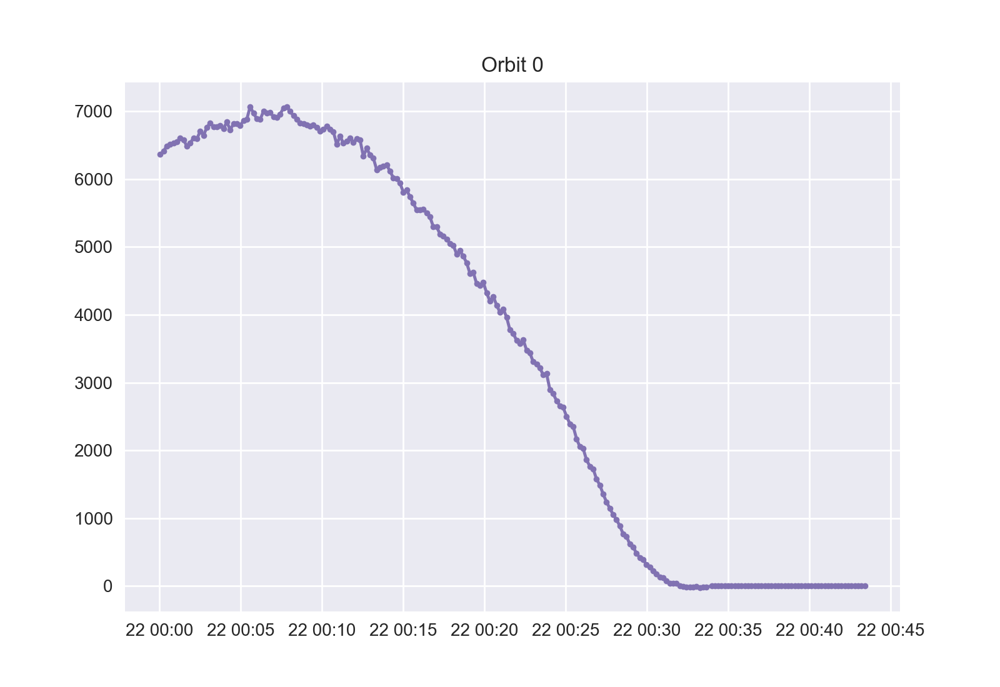

In [25]:
single_orb_plotter(orbits,0)

In [ ]:
# to fix these 'split' orbits at the start and end of the day, add in the last few hours of data from the day before/after

<IPython.core.display.Javascript object>


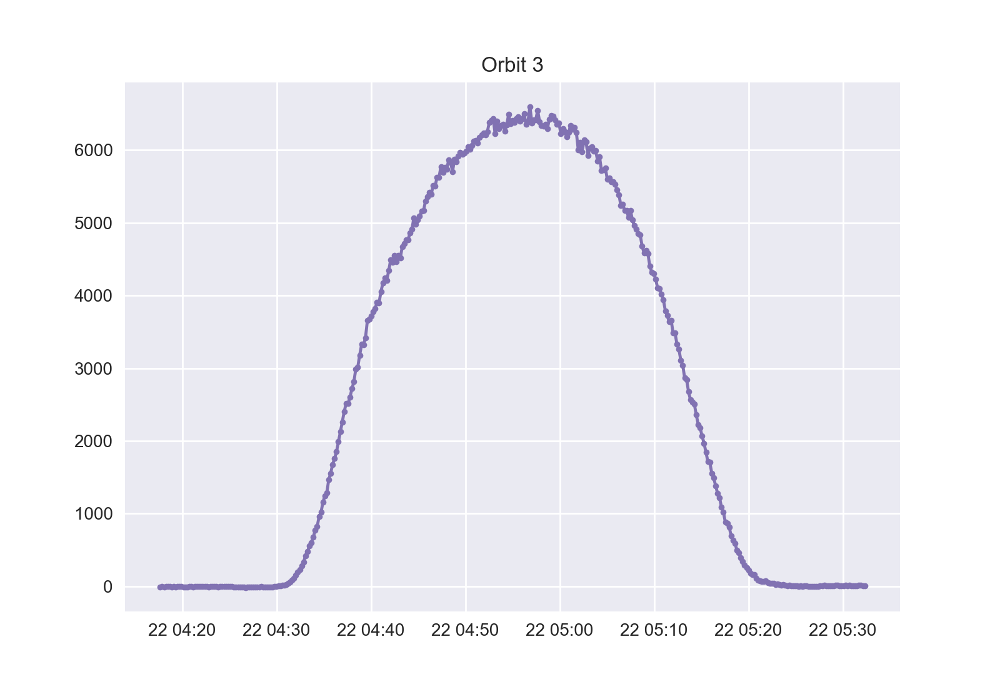

In [26]:
single_orb_plotter(orbits,3)

In [24]:
#SLay it works. Now adding in the FUV Stuff!

### FUV PLOTS FOR SINGLE ORBITS

In [27]:
sel_orb = all_orbits[0]

<IPython.core.display.Javascript object>


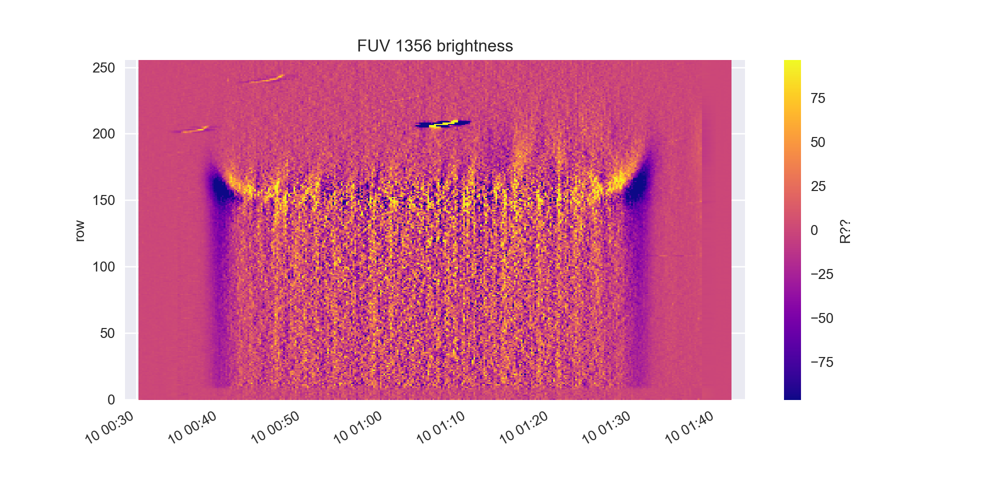

In [28]:
#FILTERING
sel_orb['I_1356_filt'] = sel_orb['I_1356'] - sel_orb['I_1356'].rolling(time=17, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)

plt.figure(figsize=(10,5))

# FUV
vm = abs(sel_orb.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(sel_orb.time.values), sel_orb.row, sel_orb.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')


plt.gcf().autofmt_xdate() 
# plt.colorbar
plt.show()

<IPython.core.display.Javascript object>


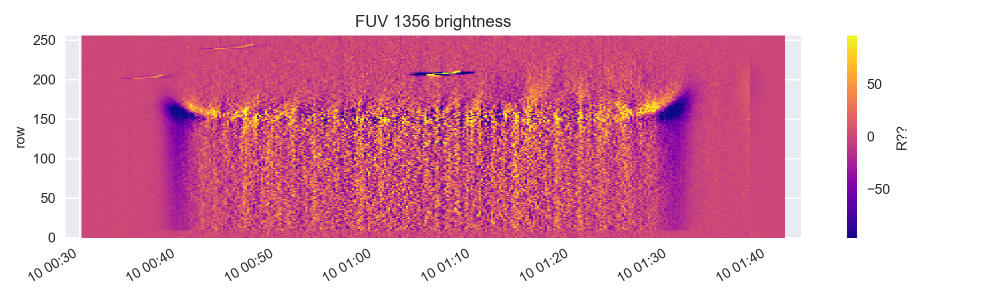

In [29]:
# Alt Match
# Which data to plot

plt.figure(figsize=(10,3))
vm = abs(sel_orb.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(sel_orb.time.values), sel_orb.row, sel_orb.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()


<IPython.core.display.Javascript object>


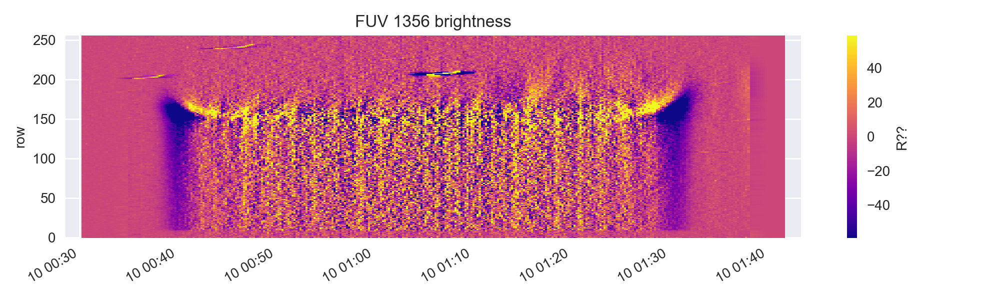

In [30]:
#SMOOTHED
dsf_plot = sel_orb.rolling(row=7, center=True).mean()

plt.figure(figsize=(10,3))

# FUV
vm = abs(sel_orb.I_1356_filt).quantile(0.95) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(sel_orb.time.values), sel_orb.row, sel_orb.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()

In [10]:
def fuv_plots_smoothed(orbit_data):
    dsf_plot = orbit_data.rolling(row=7, center=True).mean()
    orbit_data['I_1356_filt'] = orbit_data['I_1356'] - orbit_data['I_1356'].rolling(time=17, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)
    # save the mean (bg) and the pertubation separately to see if it's affecting anything
    plt.figure(figsize=(10,3))

    # FUV
    vm = abs(orbit_data.I_1356_filt).quantile(0.95) # Choose max of colorbar (i.e., contrast)
    plt.pcolormesh(pd.to_datetime(orbit_data.time.values), orbit_data.row, orbit_data.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
    plt.ylabel('row')
    plt.colorbar(label='R')
    plt.title('FUV 1356 brightness')

    plt.gcf().autofmt_xdate()
    plt.tight_layout()
    

<IPython.core.display.Javascript object>


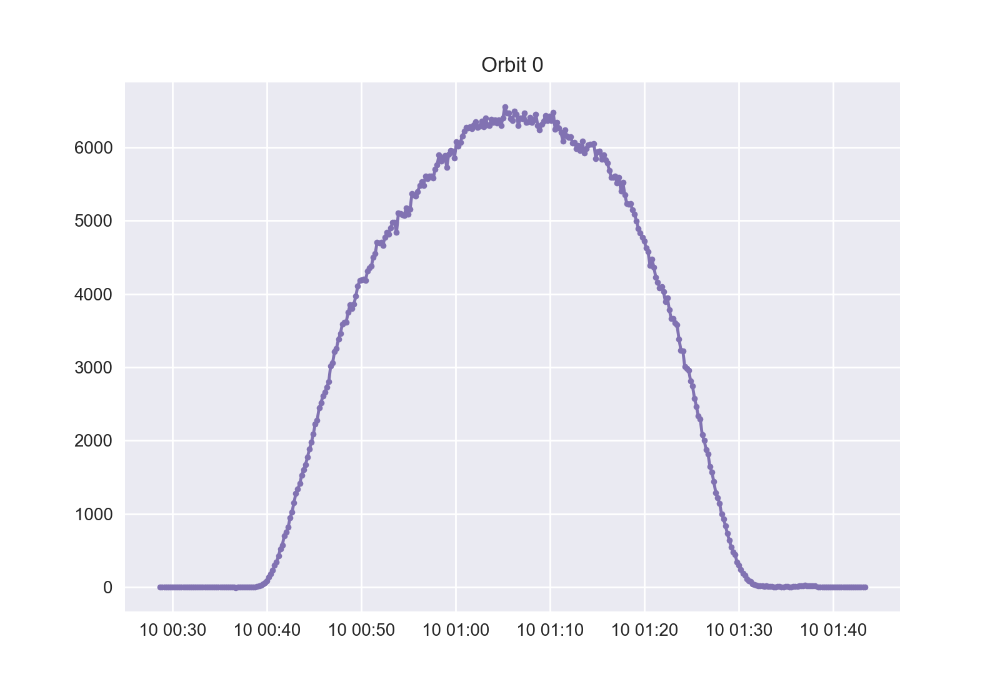

In [38]:
single_orb_plotter(all_orbits,0)

<IPython.core.display.Javascript object>


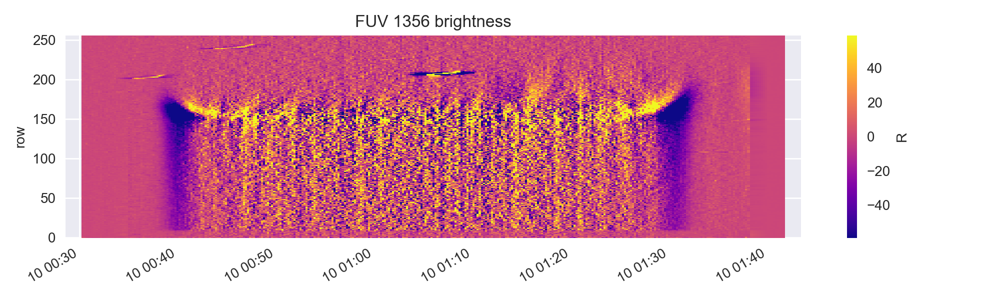

In [35]:
fuv_plots_smoothed(all_orbits[0])

<IPython.core.display.Javascript object>


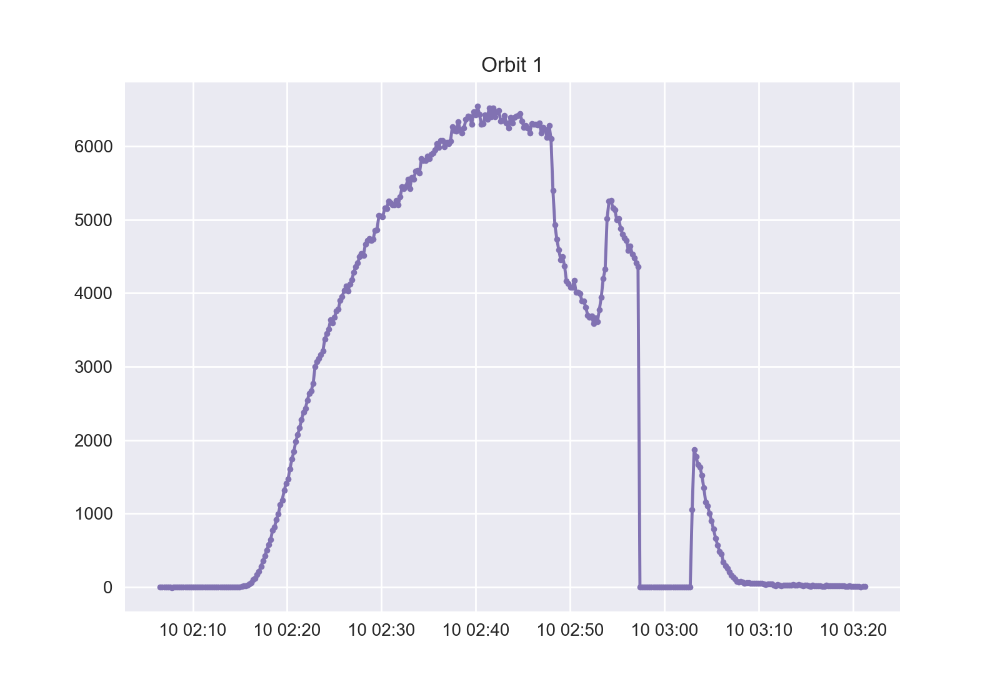

In [39]:
single_orb_plotter(all_orbits,1)

<IPython.core.display.Javascript object>


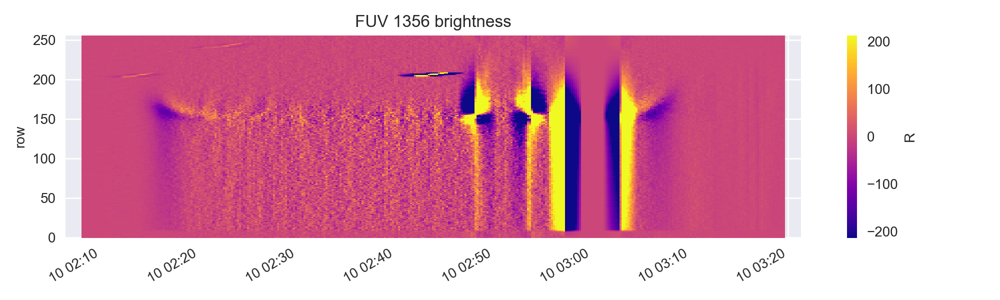

In [36]:
fuv_plots_smoothed(all_orbits[1])

<IPython.core.display.Javascript object>


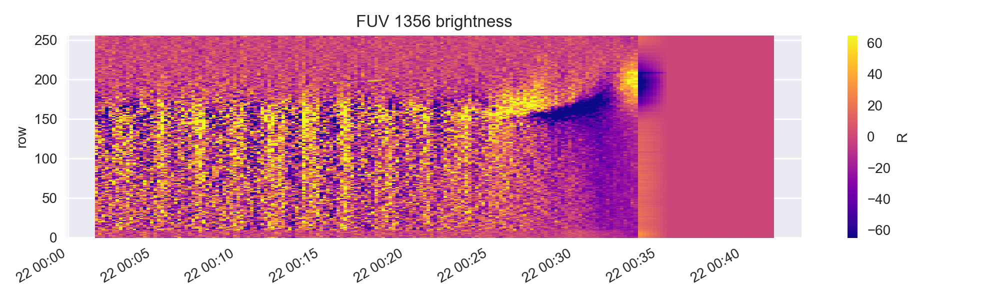

In [37]:
fuv_plots_smoothed(orbits[0])

In [11]:
## Writing a function that will take in a day of data and output all of the individual orbit plots, and the fuv plots

def plotter(data):
    all_orbits = orbits_finder(data)
    total_len = len(all_orbits)
    
    for i in range(0,total_len):
        single_orb_plotter(all_orbits,i)
        fuv_plots_smoothed(all_orbits[i])

<IPython.core.display.Javascript object>


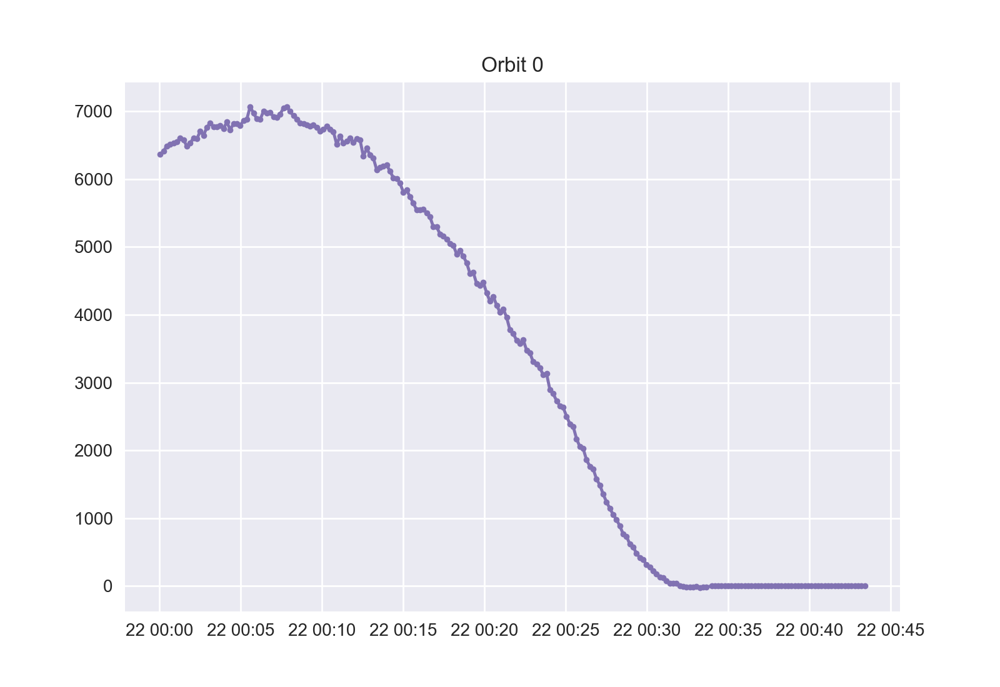

<IPython.core.display.Javascript object>


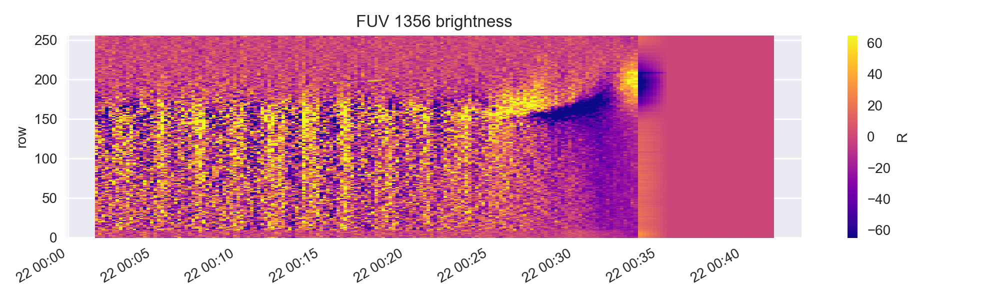

C:\Users\pkoll\AppData\Local\Temp\ipykernel_19080\3438586180.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


<IPython.core.display.Javascript object>


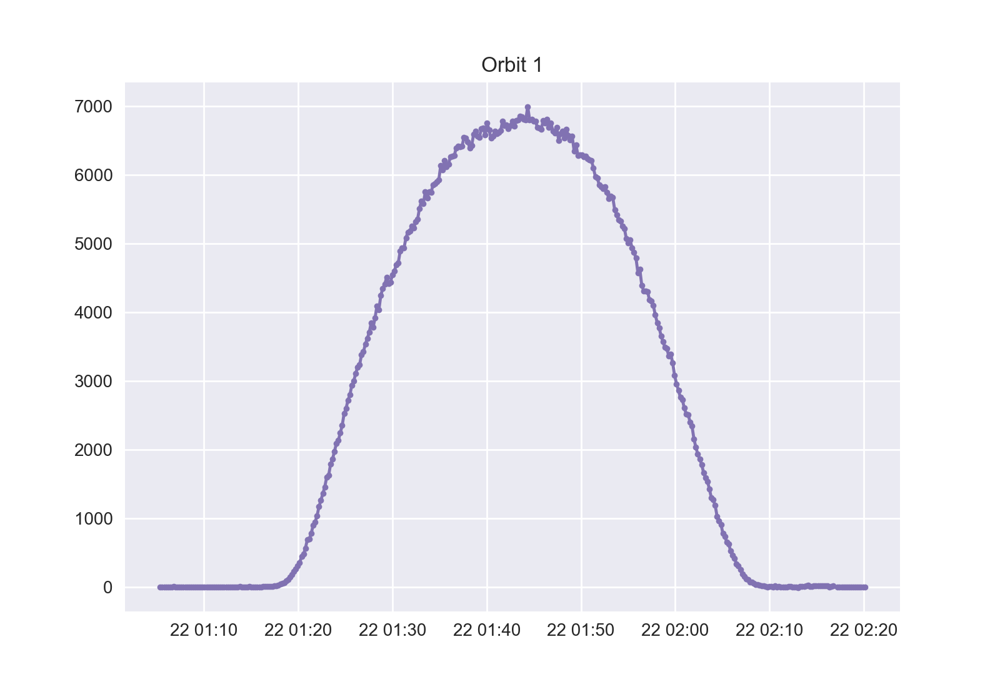

<IPython.core.display.Javascript object>


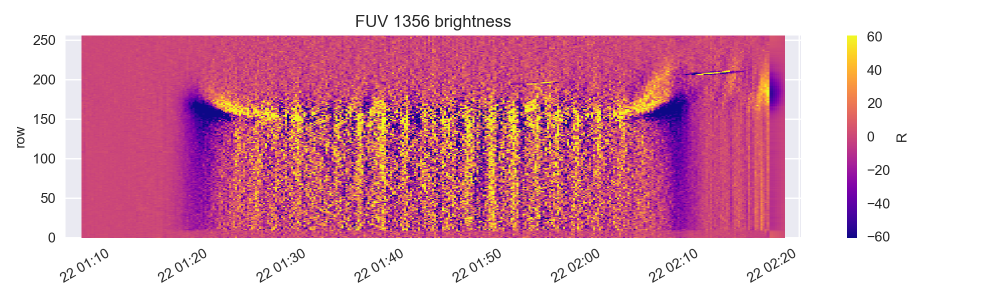

<IPython.core.display.Javascript object>


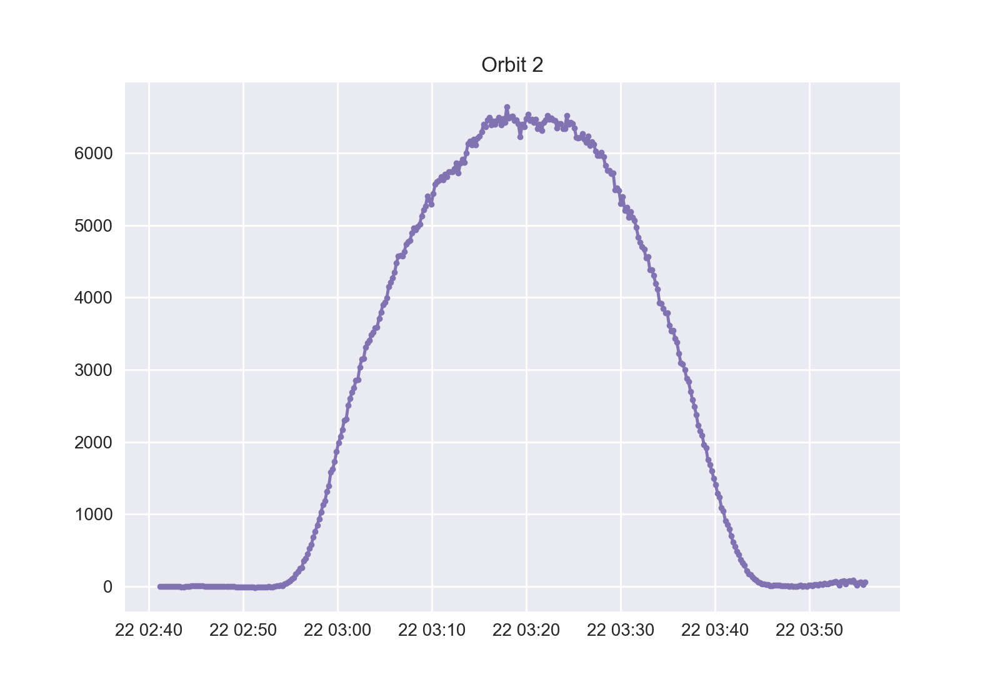

<IPython.core.display.Javascript object>


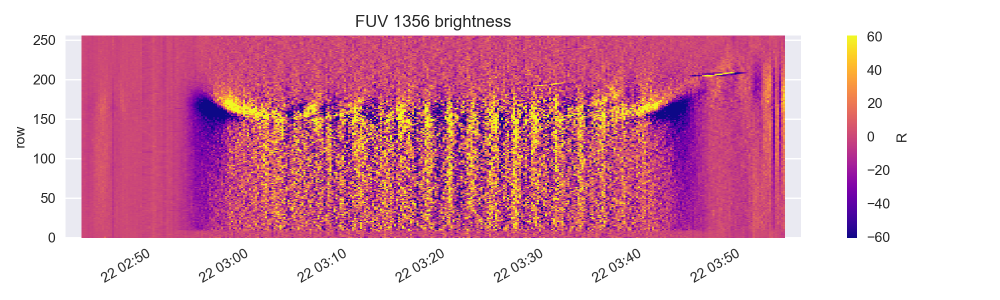

<IPython.core.display.Javascript object>


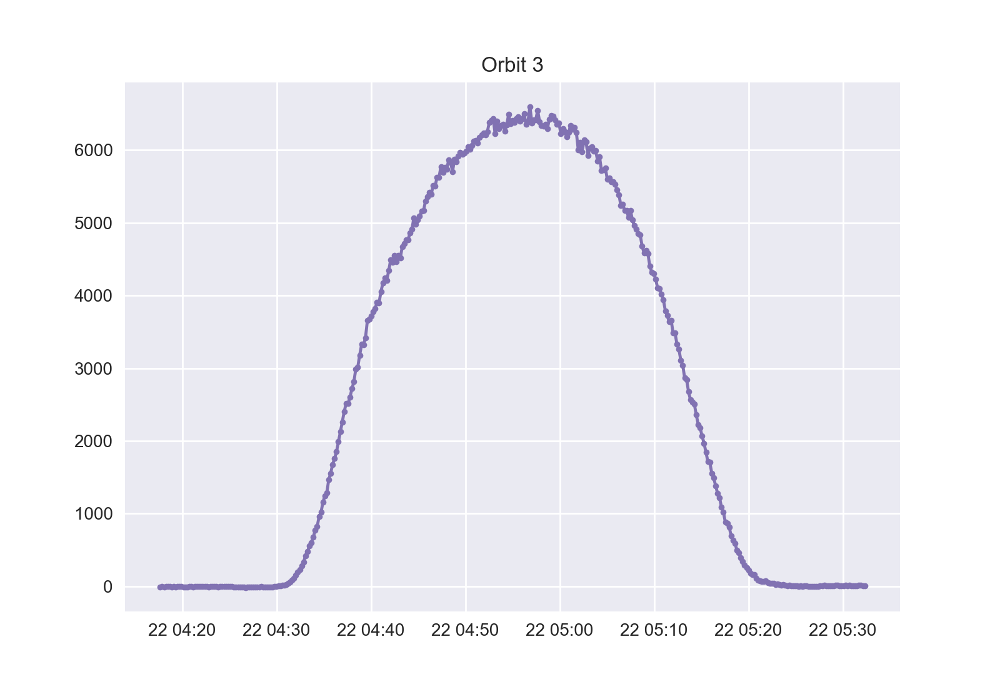

<IPython.core.display.Javascript object>


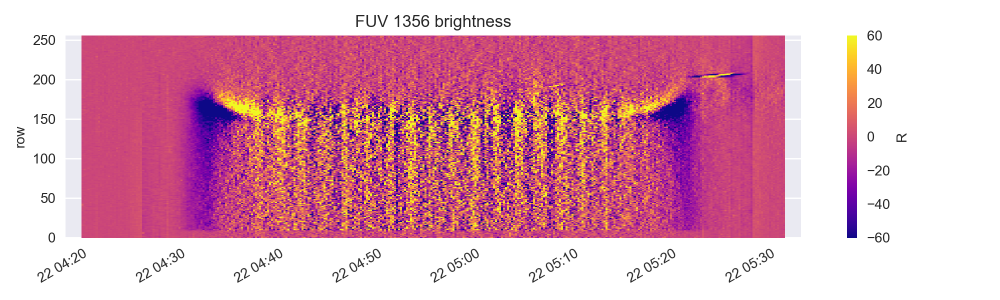

<IPython.core.display.Javascript object>


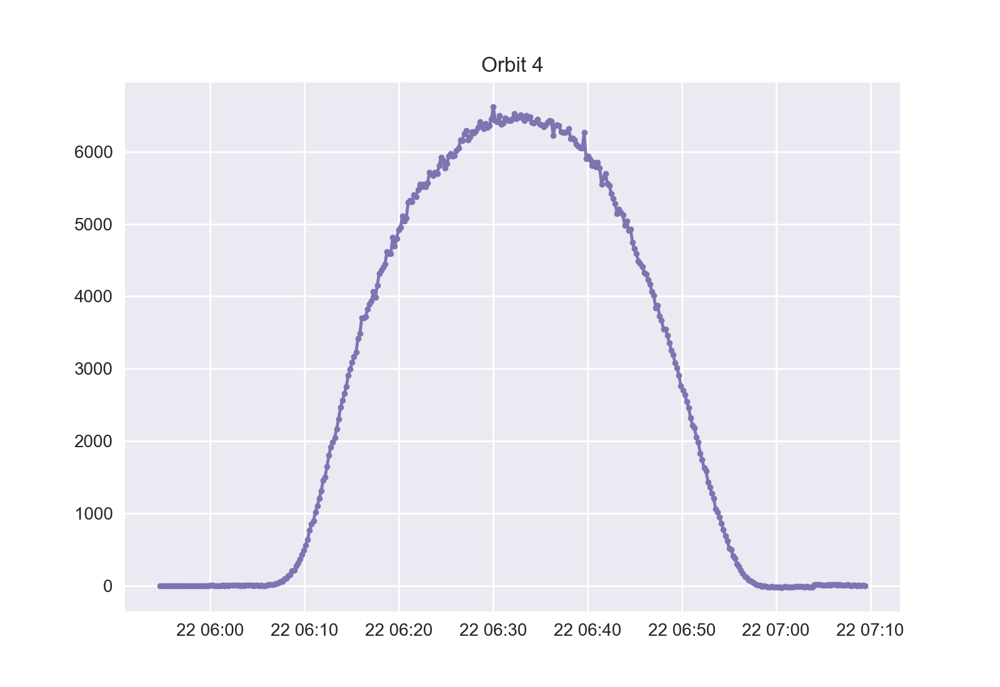

<IPython.core.display.Javascript object>


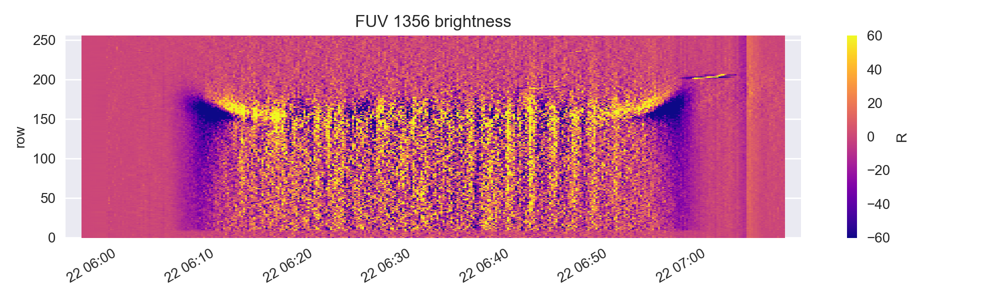

<IPython.core.display.Javascript object>


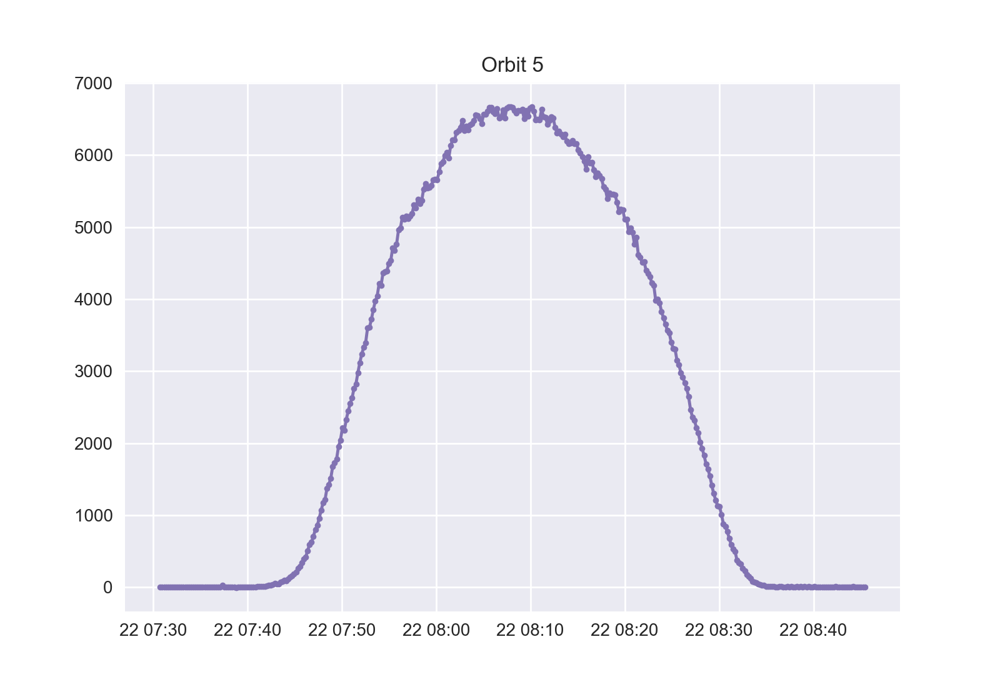

<IPython.core.display.Javascript object>


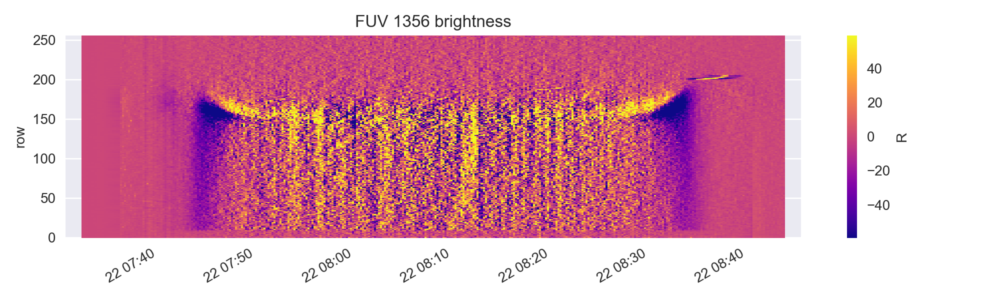

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


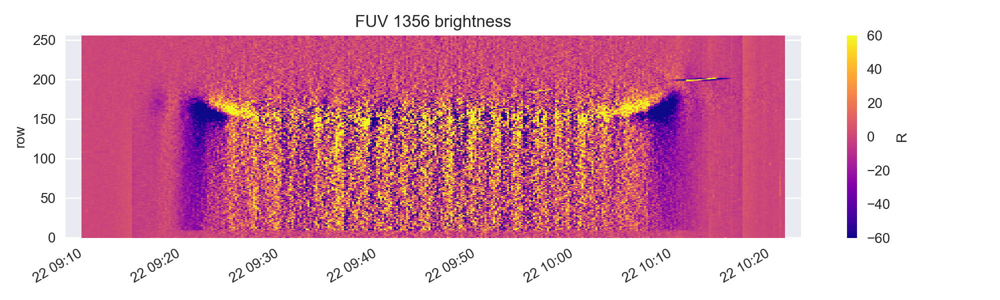

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


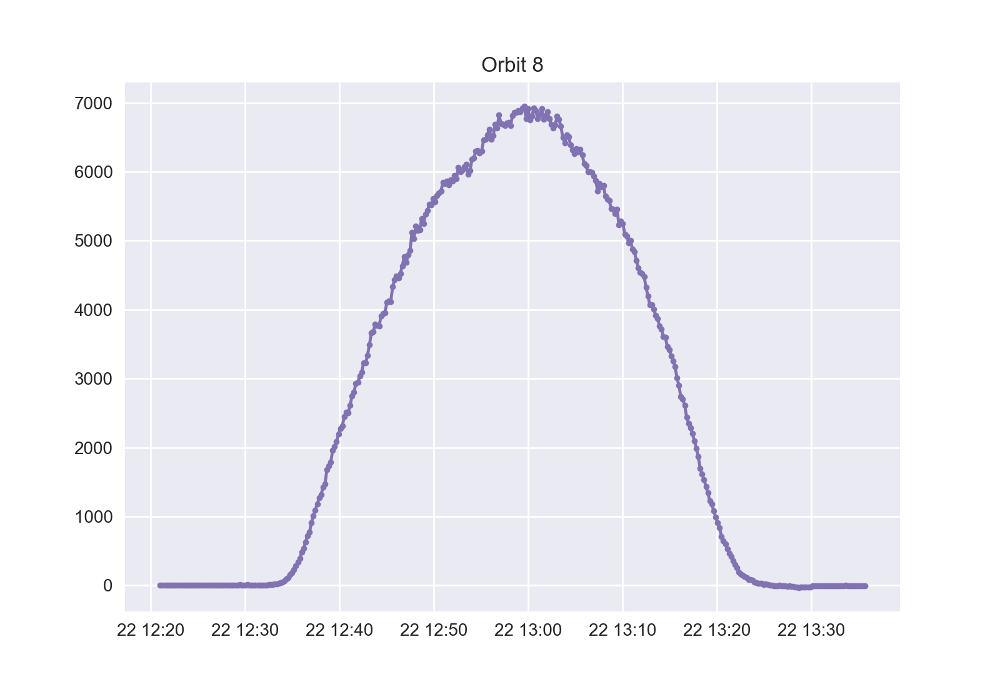

<IPython.core.display.Javascript object>


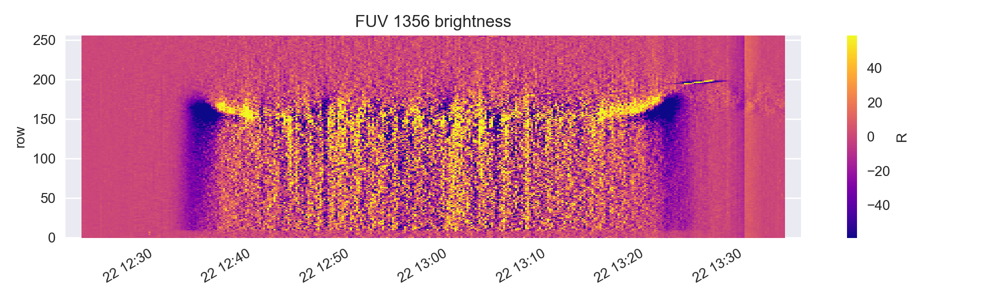

<IPython.core.display.Javascript object>


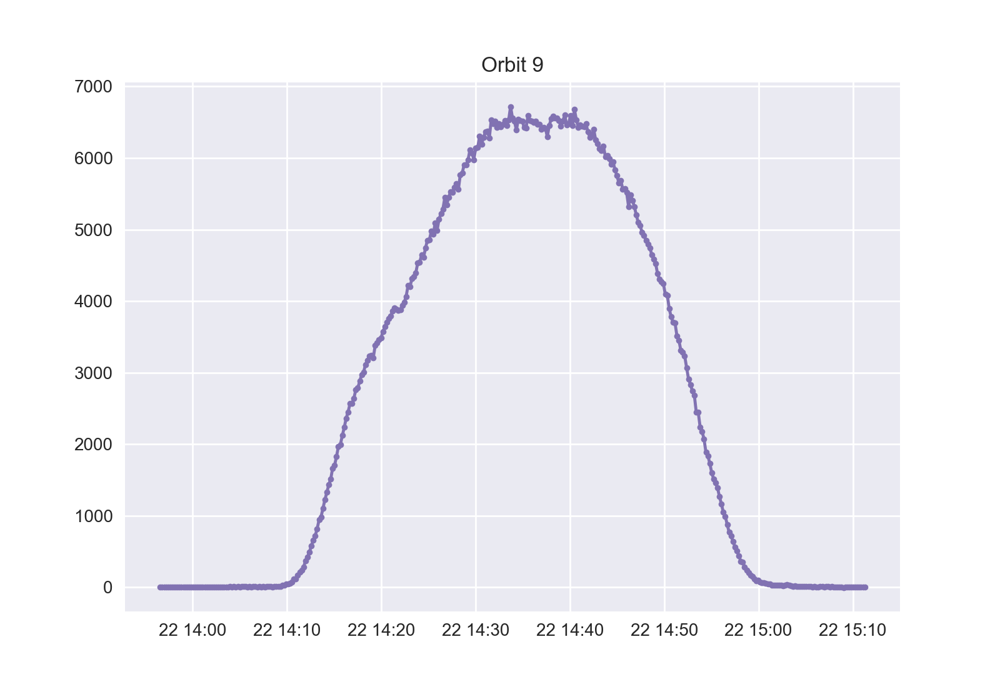

<IPython.core.display.Javascript object>


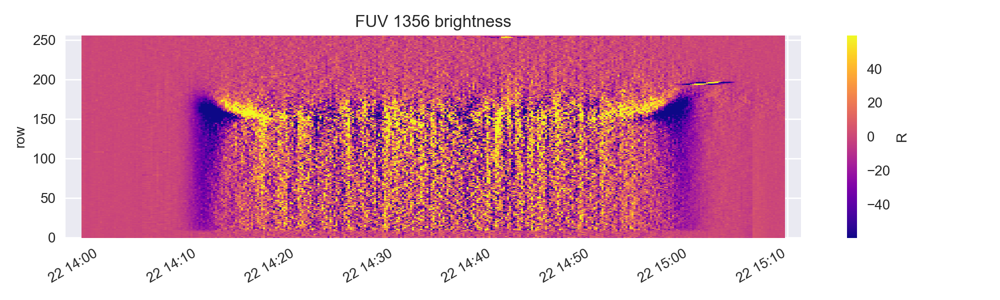

<IPython.core.display.Javascript object>


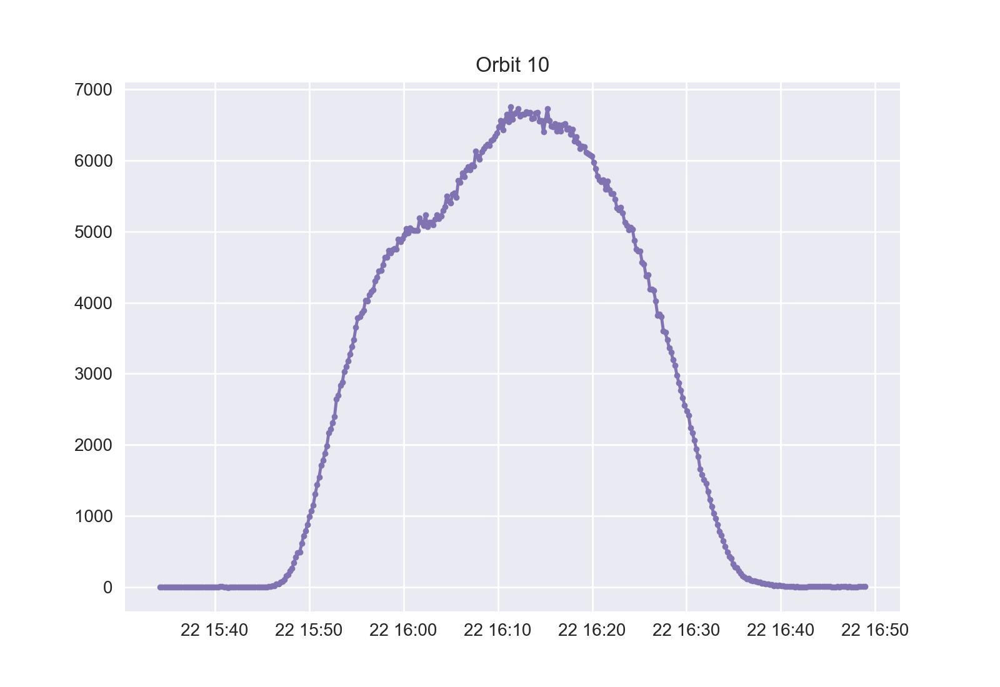

<IPython.core.display.Javascript object>


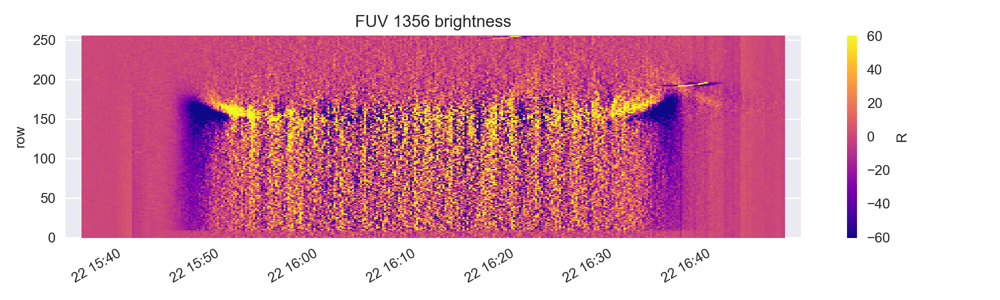

<IPython.core.display.Javascript object>


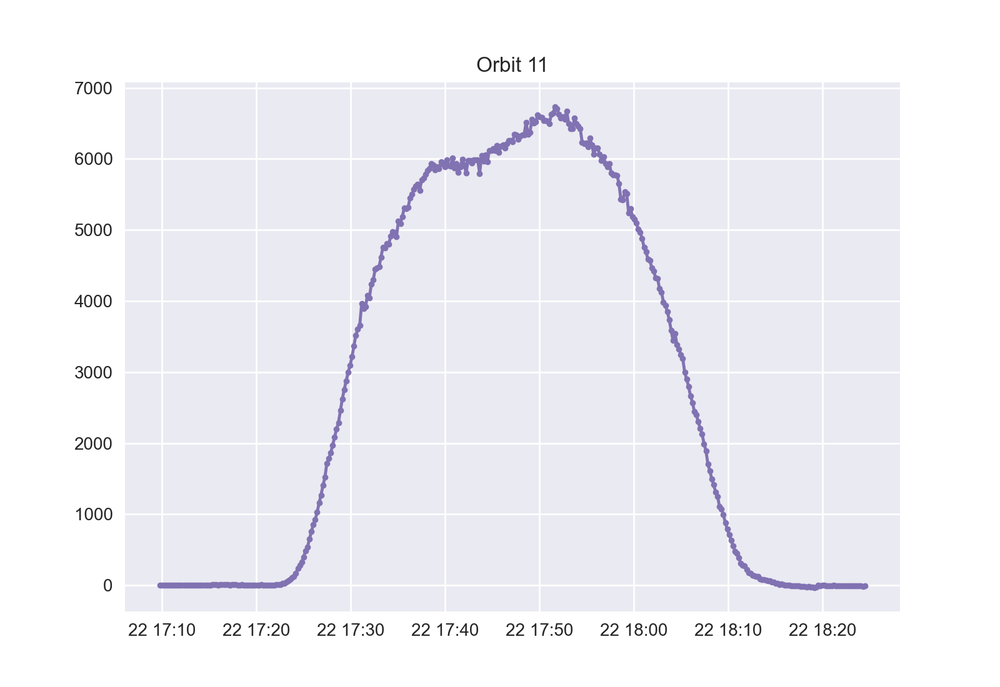

<IPython.core.display.Javascript object>


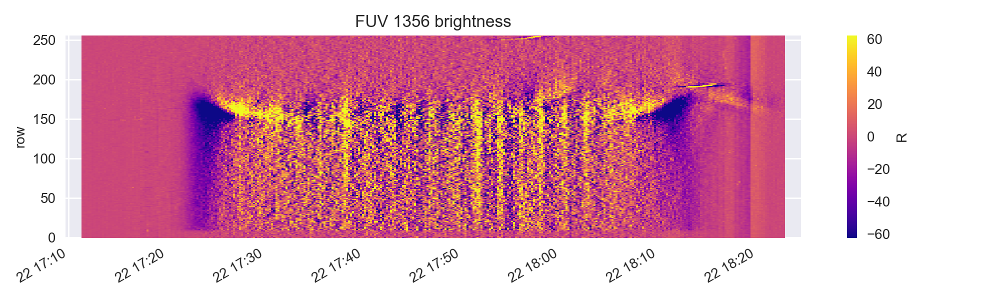

<IPython.core.display.Javascript object>


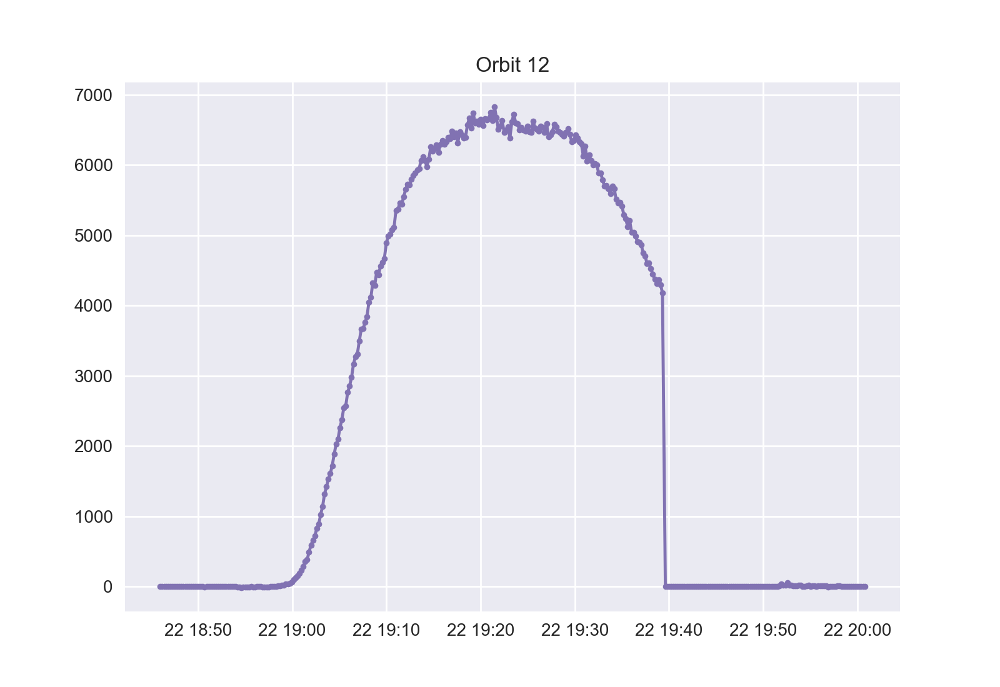

<IPython.core.display.Javascript object>


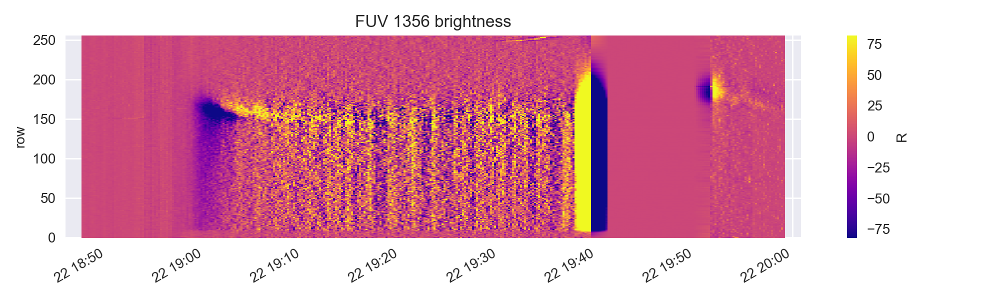

<IPython.core.display.Javascript object>


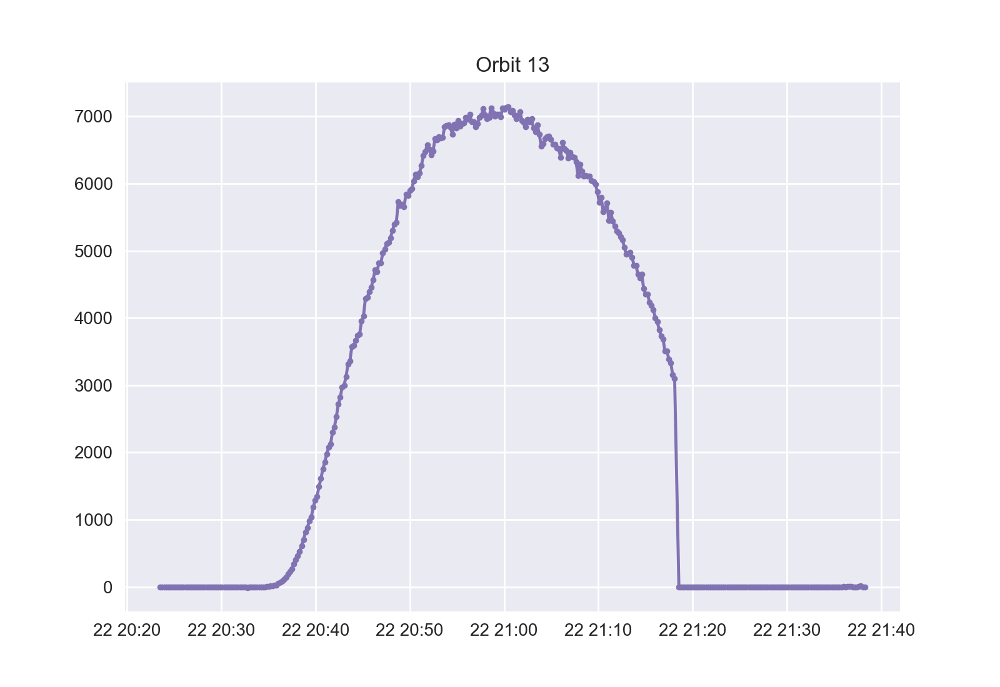

<IPython.core.display.Javascript object>


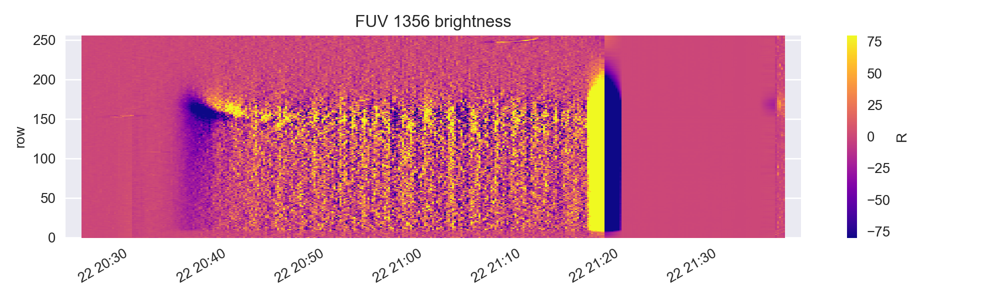

<IPython.core.display.Javascript object>


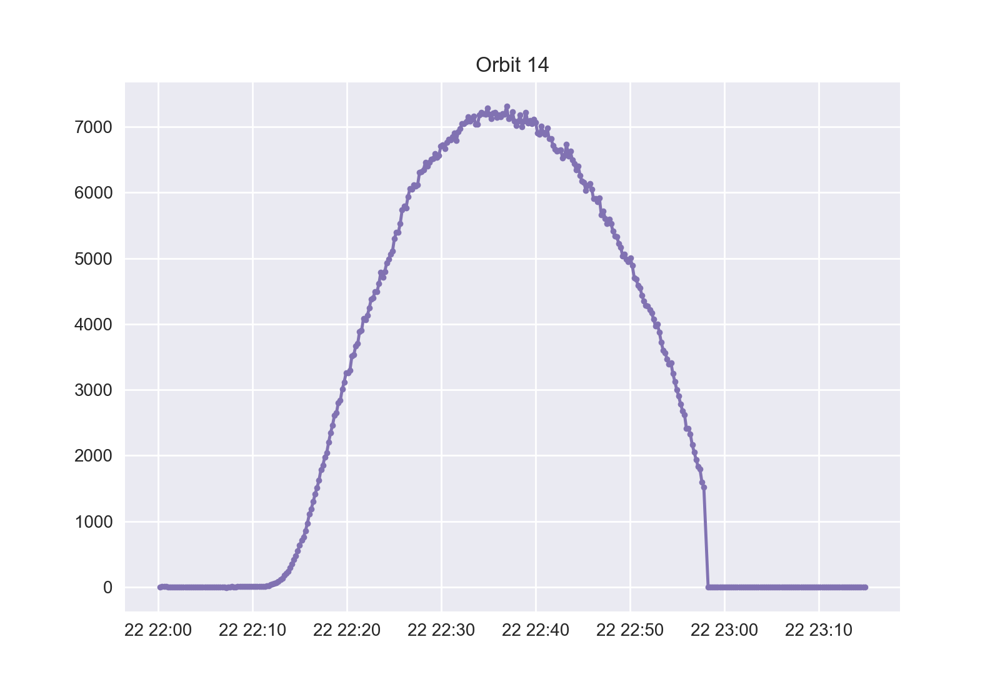

<IPython.core.display.Javascript object>


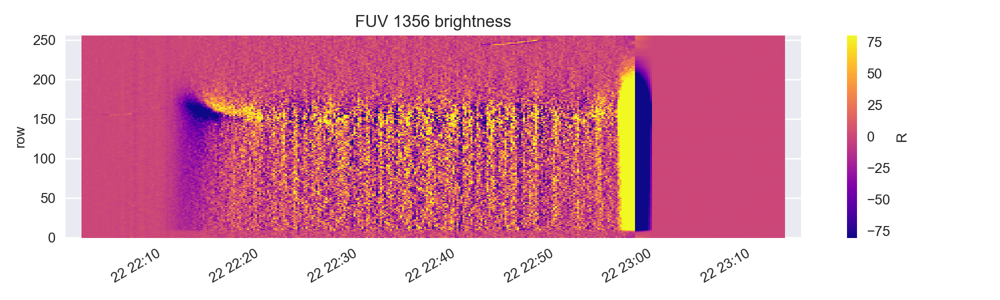

IndexError: list index out of range

In [49]:
plotter(df_322)

<IPython.core.display.Javascript object>


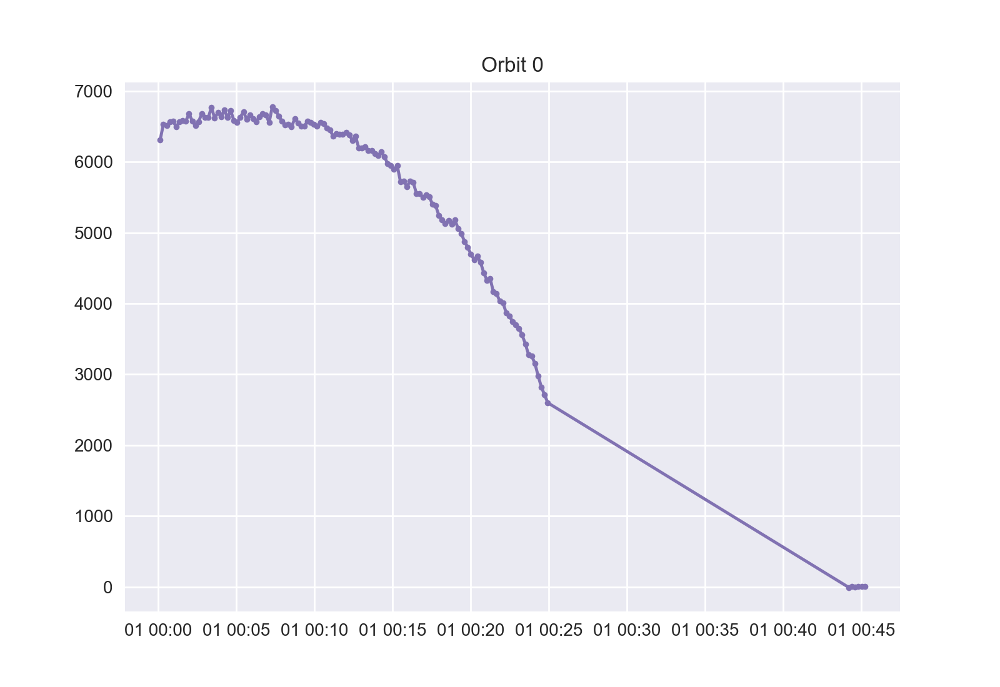

<IPython.core.display.Javascript object>


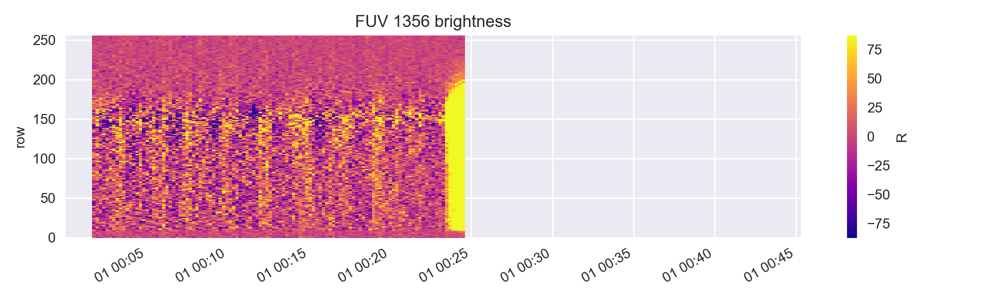

<IPython.core.display.Javascript object>


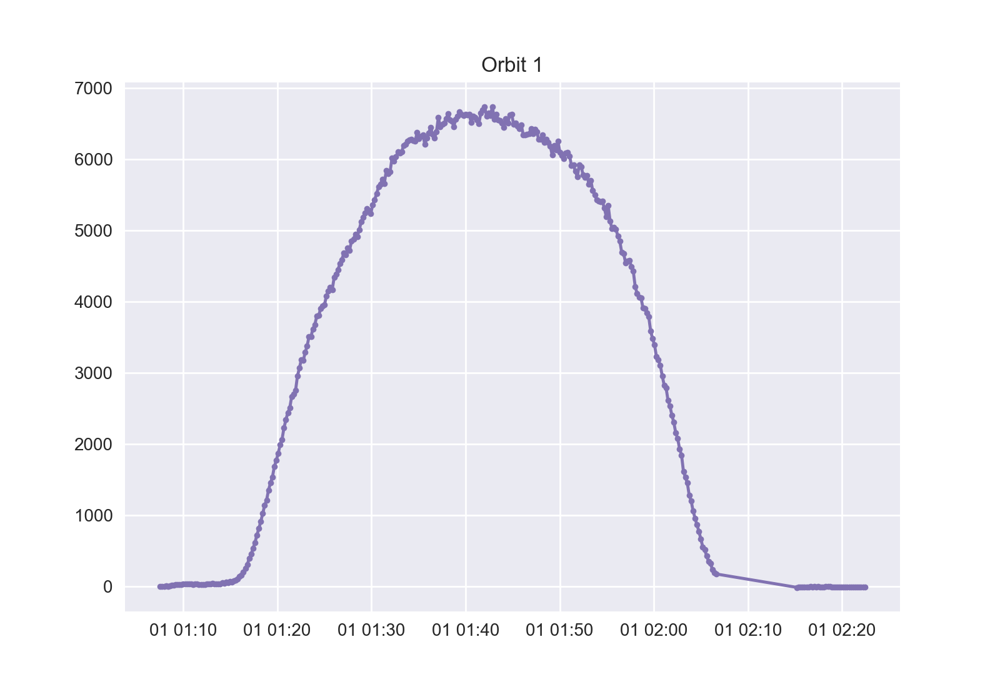

<IPython.core.display.Javascript object>


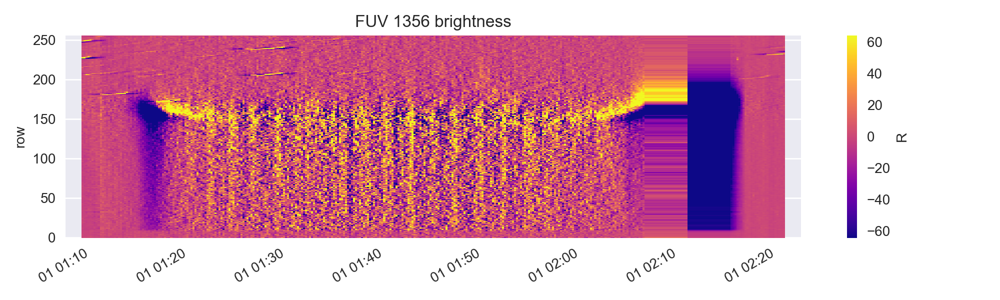

<IPython.core.display.Javascript object>


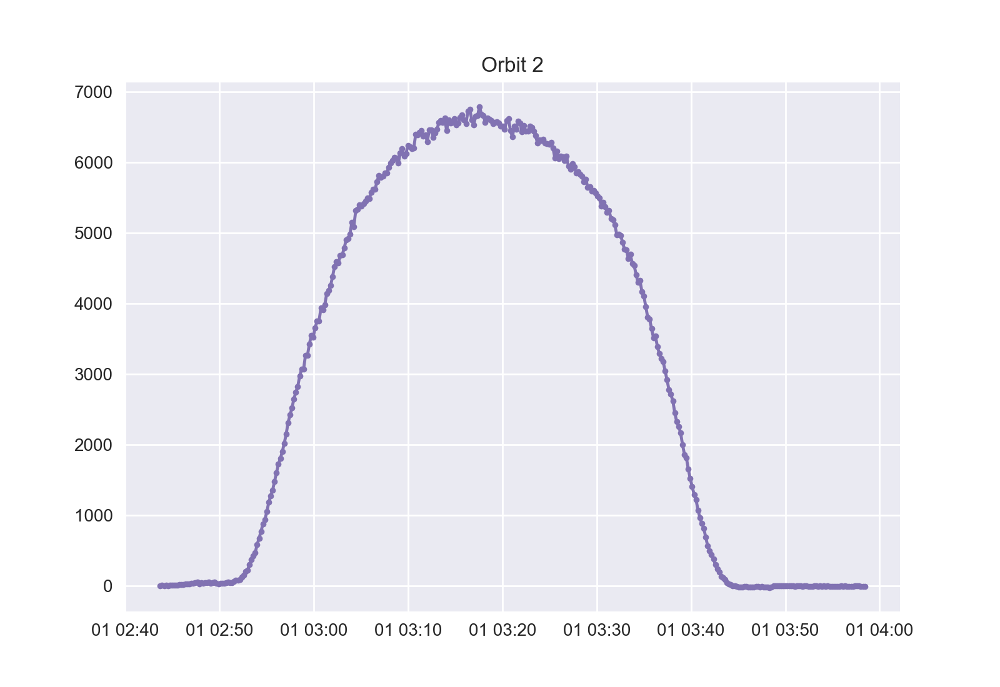

<IPython.core.display.Javascript object>


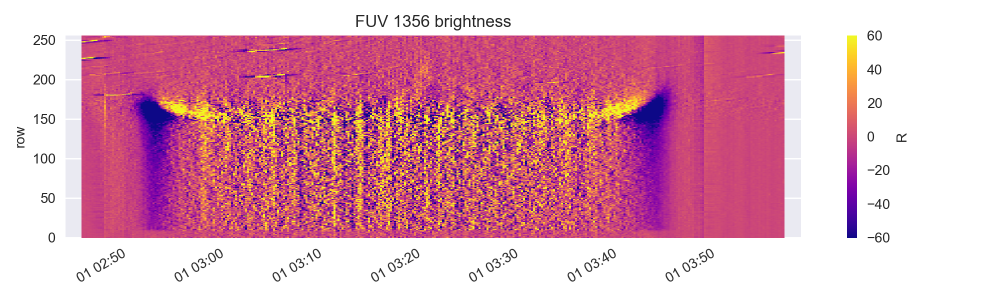

<IPython.core.display.Javascript object>


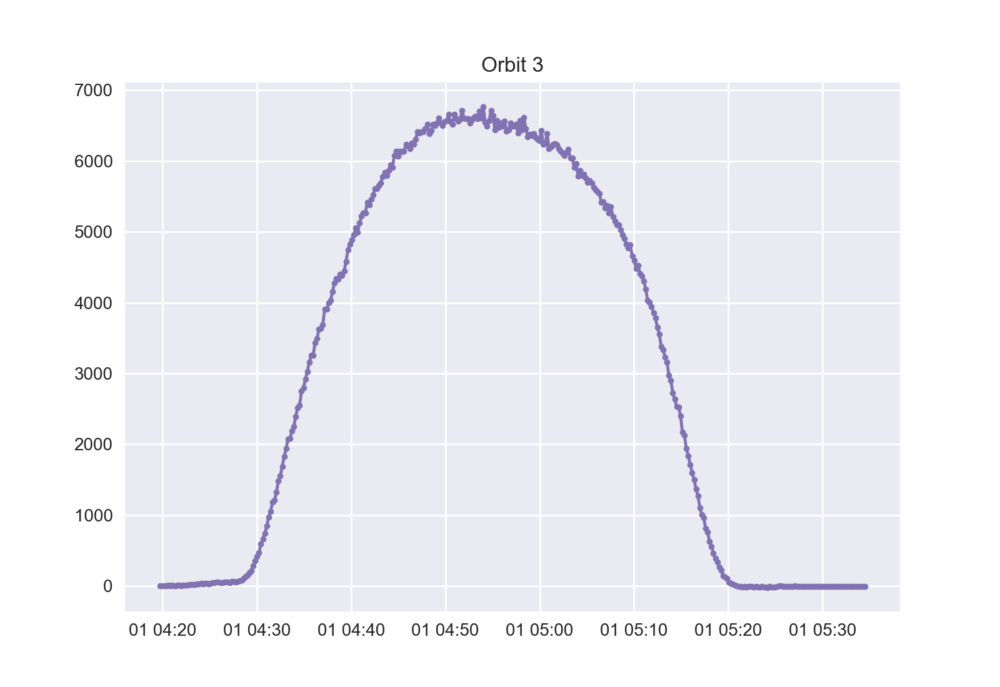

<IPython.core.display.Javascript object>


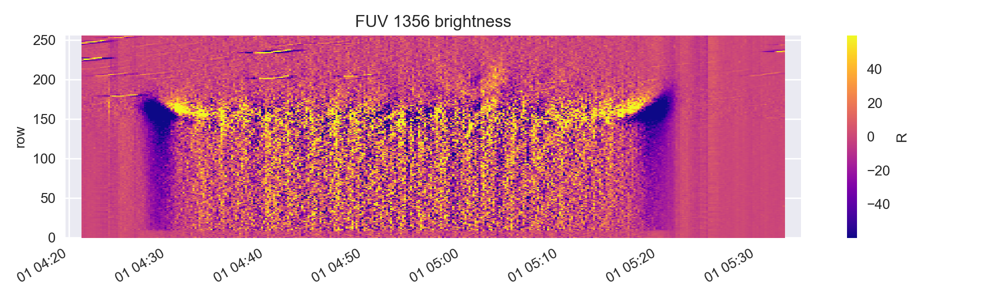

<IPython.core.display.Javascript object>


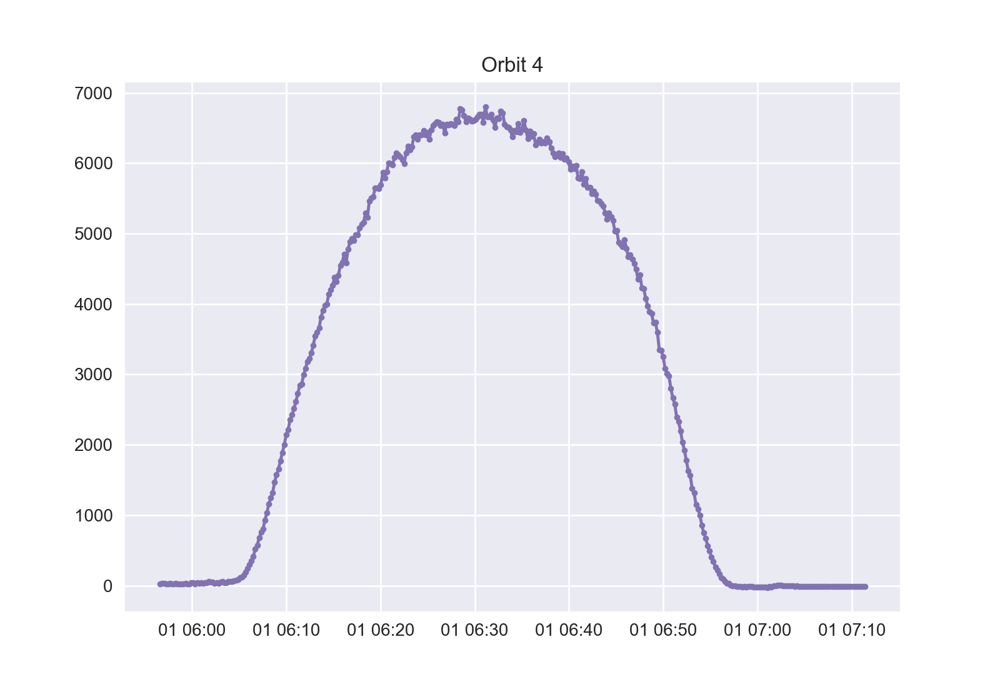

<IPython.core.display.Javascript object>


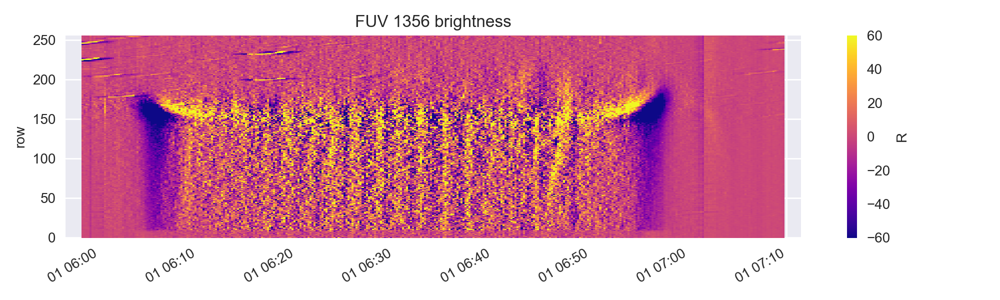

<IPython.core.display.Javascript object>


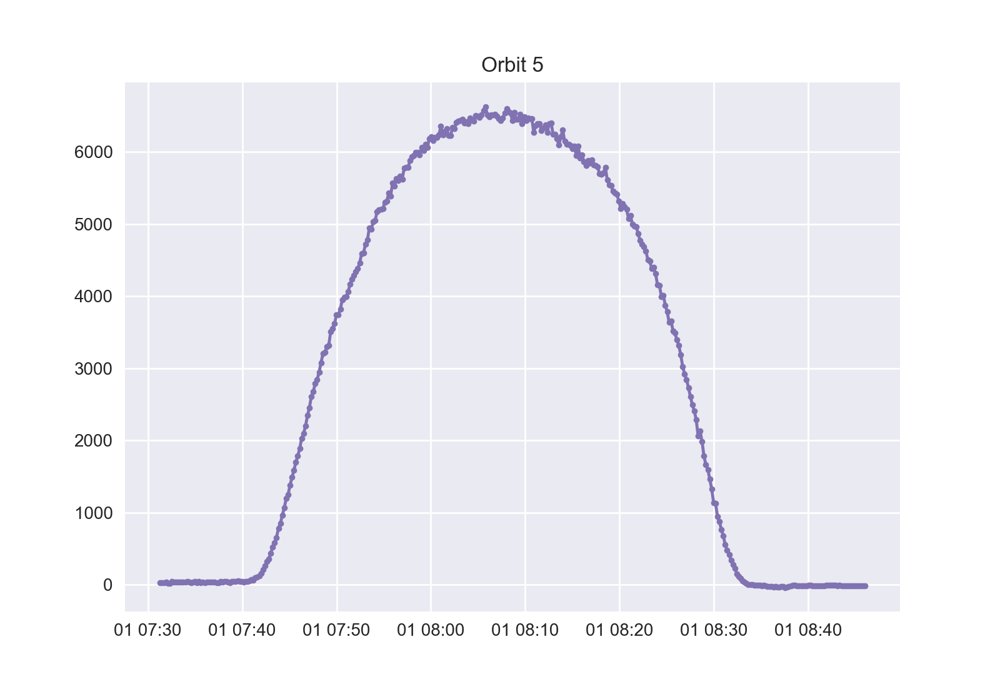

<IPython.core.display.Javascript object>


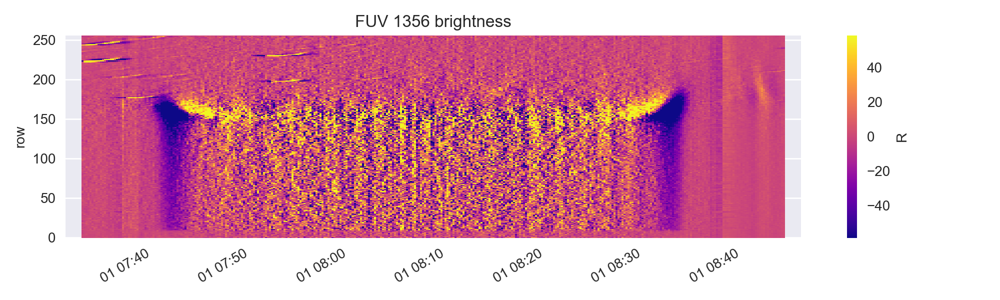

<IPython.core.display.Javascript object>


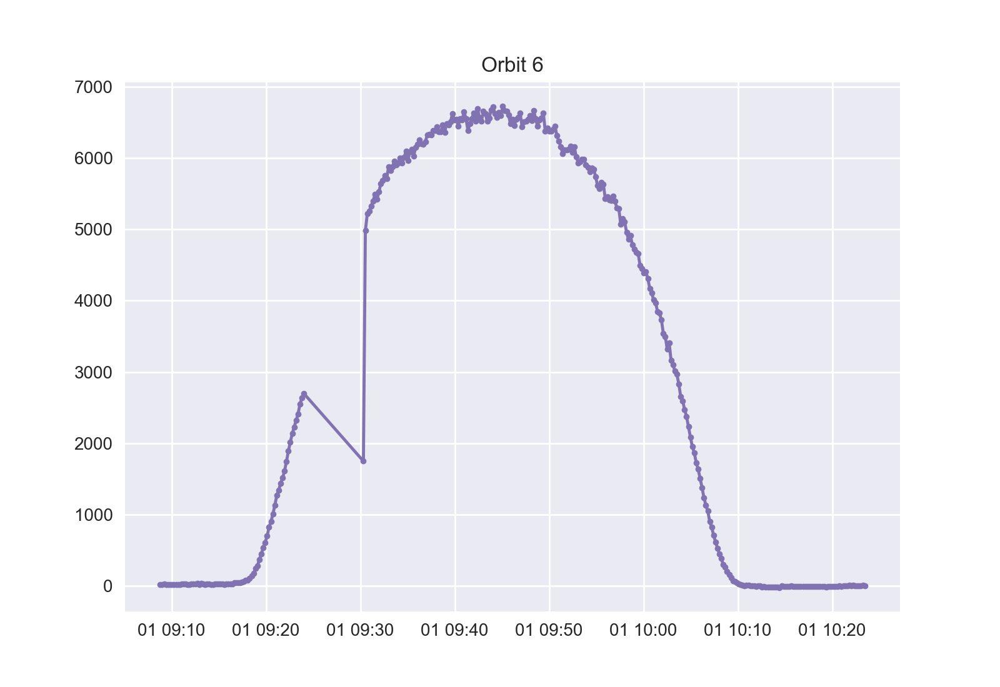

<IPython.core.display.Javascript object>


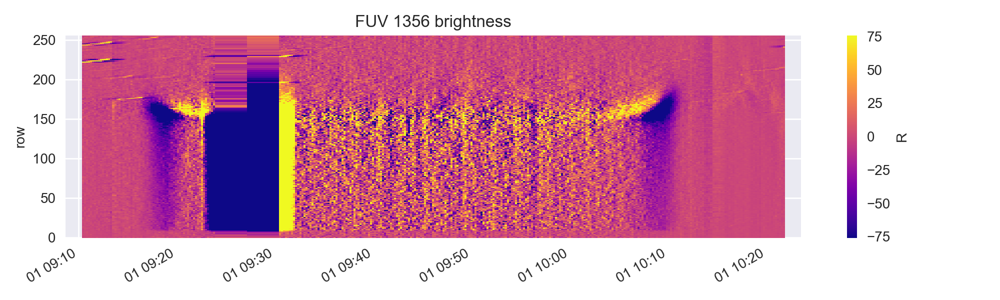

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

C:\Users\pkoll\AppData\Local\Temp\ipykernel_23412\3786029481.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


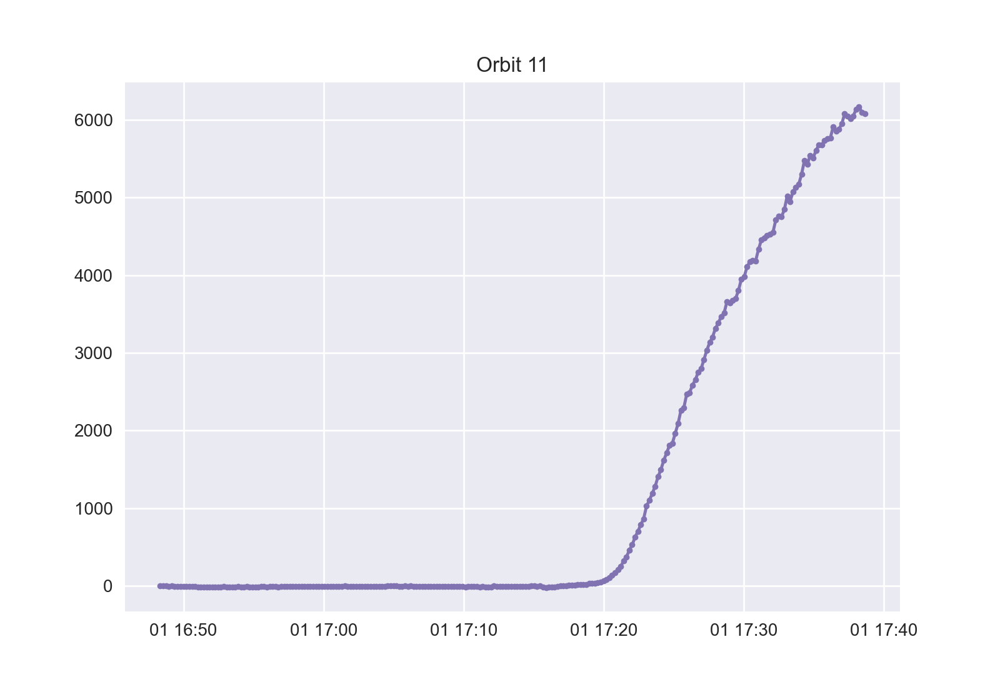

<IPython.core.display.Javascript object>


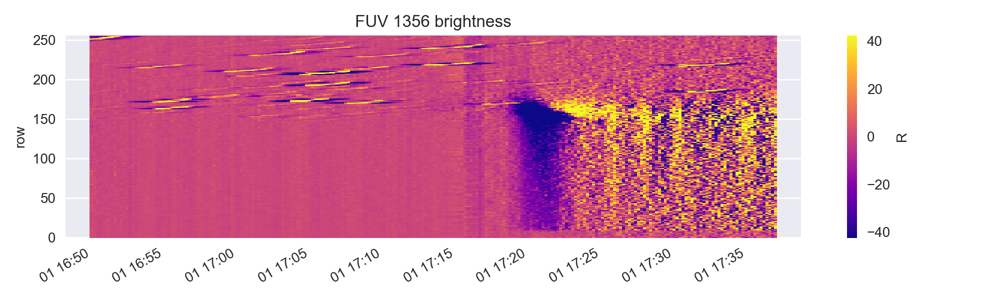

<IPython.core.display.Javascript object>


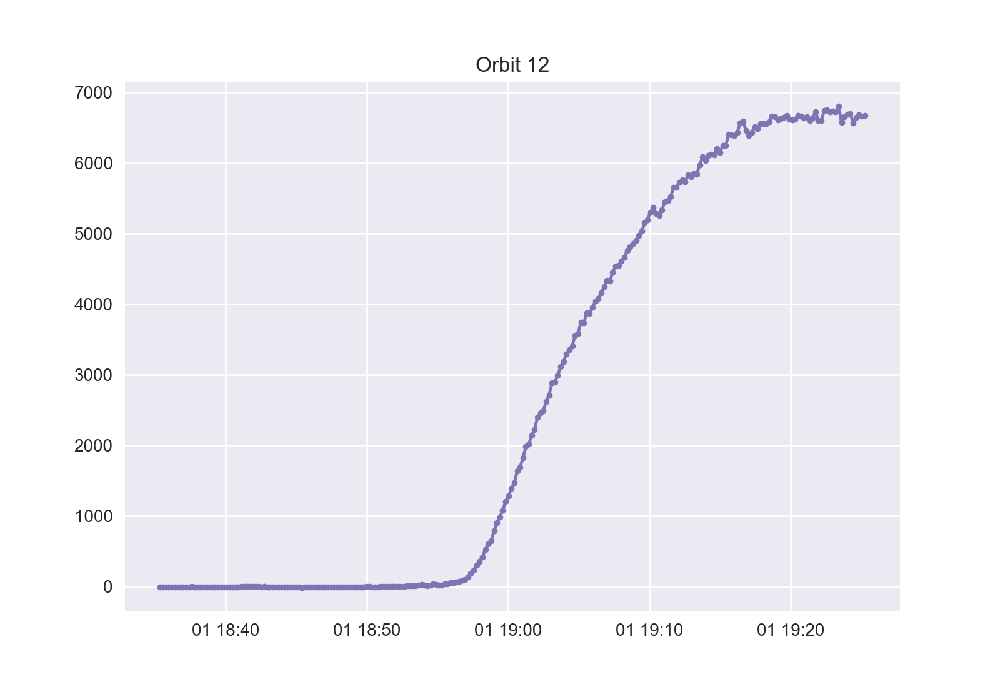

<IPython.core.display.Javascript object>


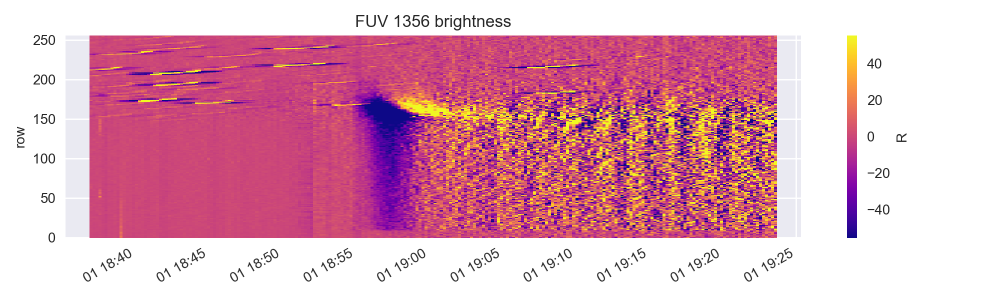

<IPython.core.display.Javascript object>


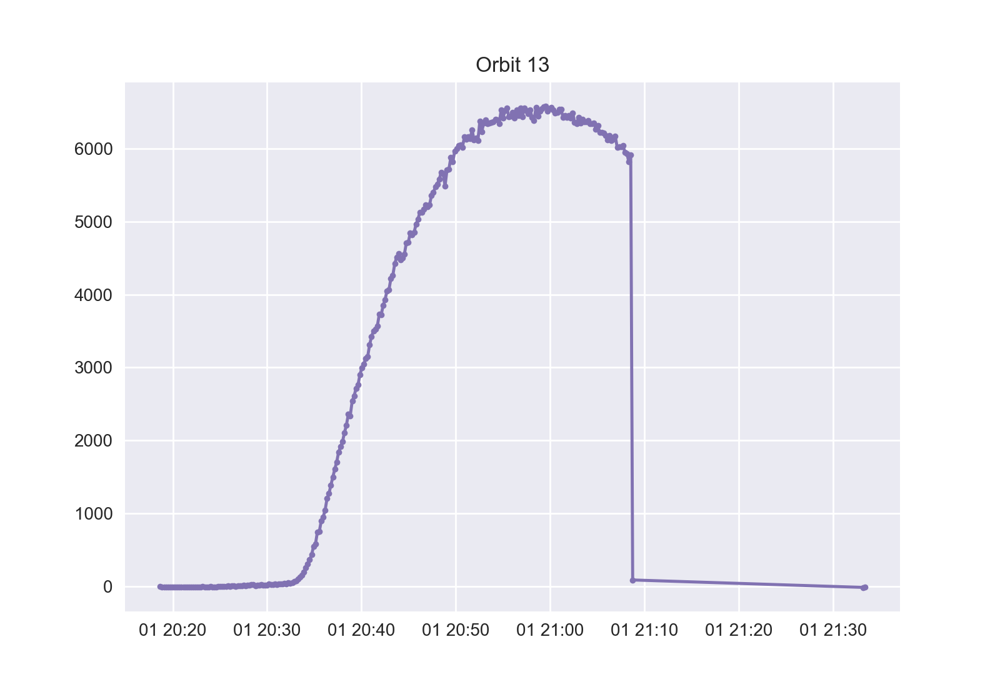

<IPython.core.display.Javascript object>


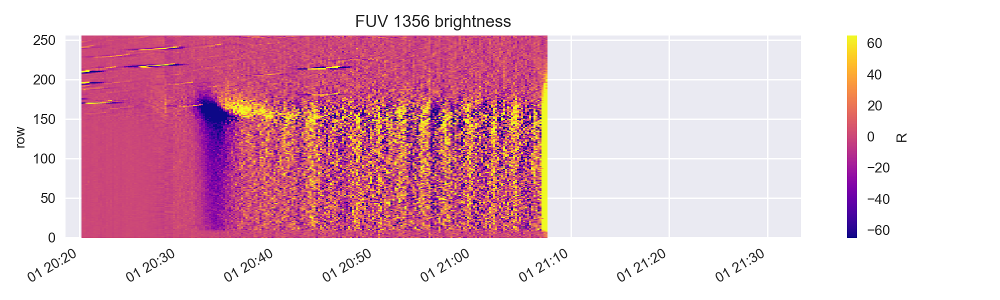

<IPython.core.display.Javascript object>


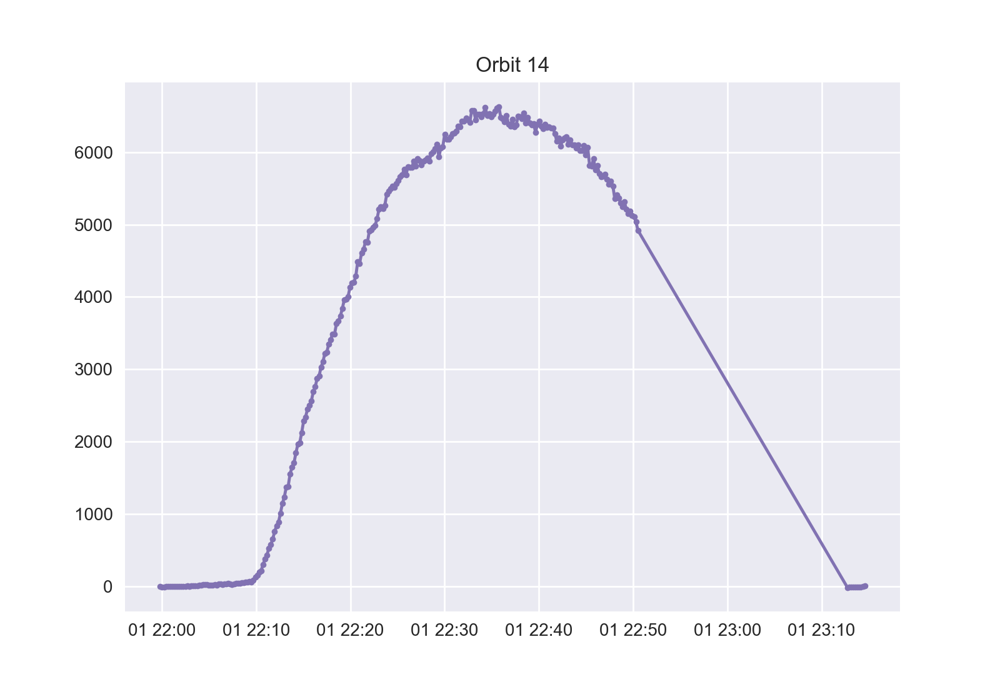

<IPython.core.display.Javascript object>


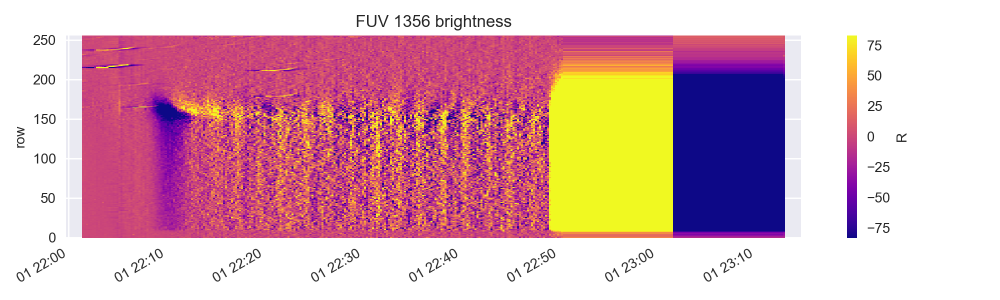

<IPython.core.display.Javascript object>


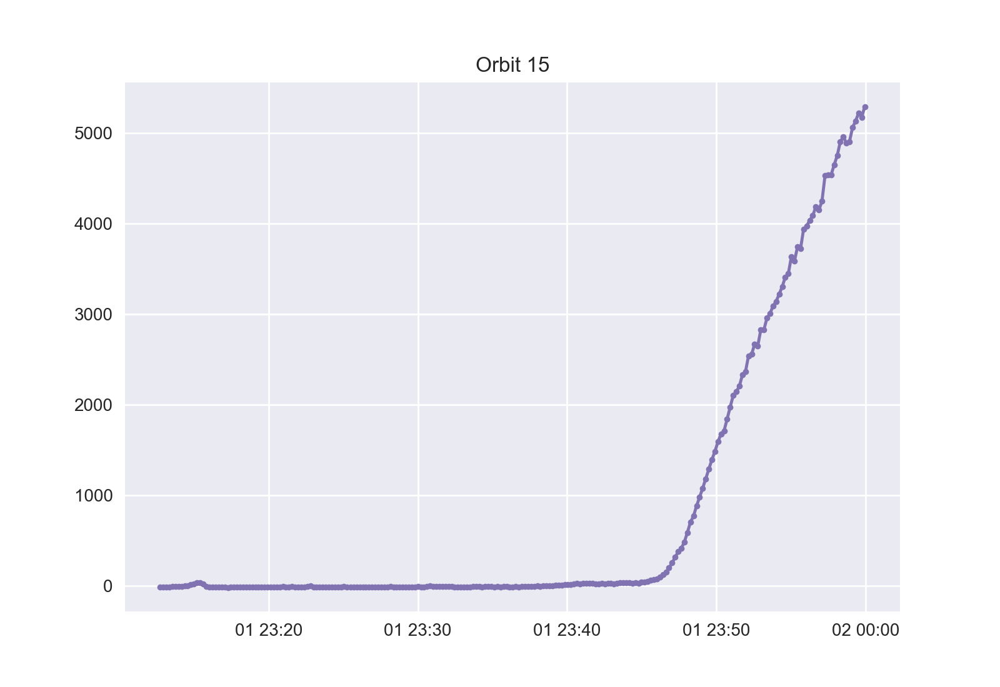

<IPython.core.display.Javascript object>


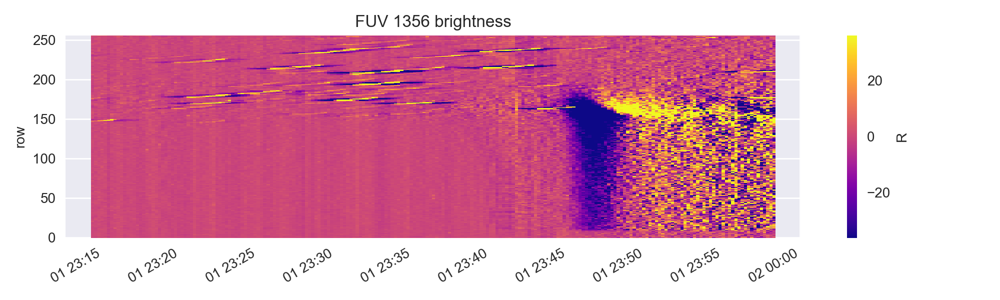

In [12]:
plotter(df_01)

In [56]:
# March 22nd, 2020
all_orbits = orbits_finder(df_322)

<IPython.core.display.Javascript object>


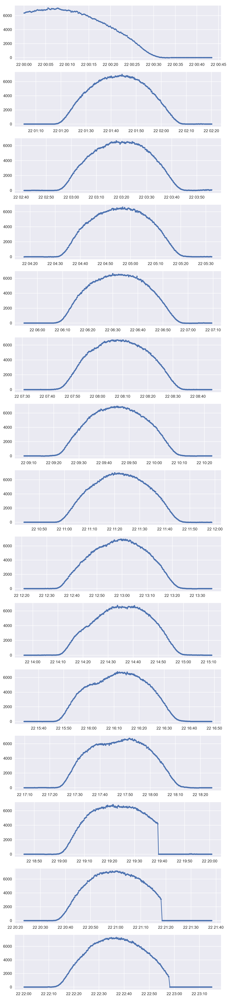

In [82]:
# Trying to generate all orbit Subplots for a Specific Day
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14, ax15) = plt.subplots(nrows=15, ncols=1, figsize = (8,35))
plt.subplots_adjust(hspace=0.5)
fig.tight_layout()
#fig.suptitle("March 22nd, 2020", fontsize=18, y=0.95)

ax1.plot(single_orb(all_orbits,0)[0],single_orb(all_orbits,0)[1], marker = '.')
ax2.plot(single_orb(all_orbits,1)[0],single_orb(all_orbits,1)[1],marker = '.')
ax3.plot(single_orb(all_orbits,2)[0],single_orb(all_orbits,2)[1],marker = '.')
ax4.plot(single_orb(all_orbits,3)[0],single_orb(all_orbits,3)[1],marker = '.')
ax5.plot(single_orb(all_orbits,4)[0],single_orb(all_orbits,4)[1],marker = '.')
ax6.plot(single_orb(all_orbits,5)[0],single_orb(all_orbits,5)[1],marker = '.')
ax7.plot(single_orb(all_orbits,6)[0],single_orb(all_orbits,6)[1],marker = '.')
ax8.plot(single_orb(all_orbits,7)[0],single_orb(all_orbits,7)[1],marker = '.')
ax9.plot(single_orb(all_orbits,8)[0],single_orb(all_orbits,8)[1],marker = '.')
ax10.plot(single_orb(all_orbits,9)[0],single_orb(all_orbits,9)[1],marker = '.')
ax11.plot(single_orb(all_orbits,10)[0],single_orb(all_orbits,10)[1],marker = '.')
ax12.plot(single_orb(all_orbits,11)[0],single_orb(all_orbits,11)[1],marker = '.')
ax13.plot(single_orb(all_orbits,12)[0],single_orb(all_orbits,12)[1],marker = '.')
ax14.plot(single_orb(all_orbits,13)[0],single_orb(all_orbits,13)[1],marker = '.')
ax15.plot(single_orb(all_orbits,14)[0],single_orb(all_orbits,14)[1],marker = '.')

plt.savefig('Orbits of March 22nd')

<IPython.core.display.Javascript object>


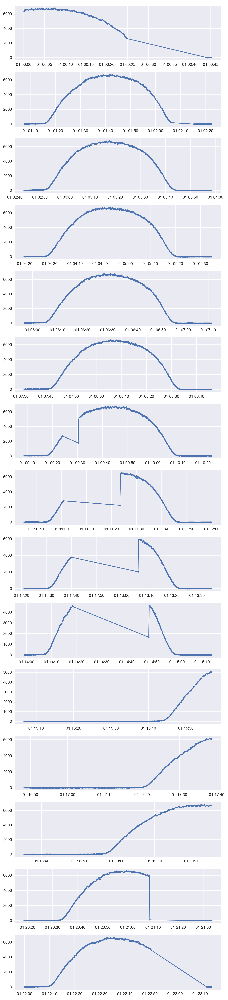

In [83]:
## JAN 1ST 
all_orbits = orbits_finder(df_01)
# Trying to generate all orbit Subplots for a Specific Day
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14, ax15) = plt.subplots(nrows=15, ncols=1, figsize = (8,35))
plt.subplots_adjust(hspace=0.5)
fig.tight_layout()
#fig.suptitle("March 22nd, 2020", fontsize=18, y=0.95)

ax1.plot(single_orb(all_orbits,0)[0],single_orb(all_orbits,0)[1], marker = '.')
ax2.plot(single_orb(all_orbits,1)[0],single_orb(all_orbits,1)[1],marker = '.')
ax3.plot(single_orb(all_orbits,2)[0],single_orb(all_orbits,2)[1],marker = '.')
ax4.plot(single_orb(all_orbits,3)[0],single_orb(all_orbits,3)[1],marker = '.')
ax5.plot(single_orb(all_orbits,4)[0],single_orb(all_orbits,4)[1],marker = '.')
ax6.plot(single_orb(all_orbits,5)[0],single_orb(all_orbits,5)[1],marker = '.')
ax7.plot(single_orb(all_orbits,6)[0],single_orb(all_orbits,6)[1],marker = '.')
ax8.plot(single_orb(all_orbits,7)[0],single_orb(all_orbits,7)[1],marker = '.')
ax9.plot(single_orb(all_orbits,8)[0],single_orb(all_orbits,8)[1],marker = '.')
ax10.plot(single_orb(all_orbits,9)[0],single_orb(all_orbits,9)[1],marker = '.')
ax11.plot(single_orb(all_orbits,10)[0],single_orb(all_orbits,10)[1],marker = '.')
ax12.plot(single_orb(all_orbits,11)[0],single_orb(all_orbits,11)[1],marker = '.')
ax13.plot(single_orb(all_orbits,12)[0],single_orb(all_orbits,12)[1],marker = '.')
ax14.plot(single_orb(all_orbits,13)[0],single_orb(all_orbits,13)[1],marker = '.')
ax15.plot(single_orb(all_orbits,14)[0],single_orb(all_orbits,14)[1],marker = '.')

plt.savefig('Orbits of Jan 1st')

<IPython.core.display.Javascript object>


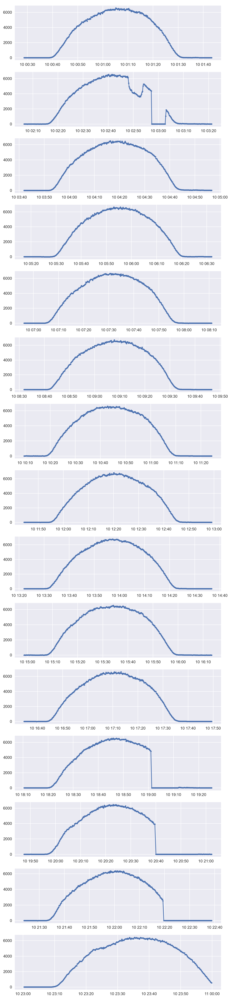

In [87]:
## MAY 10th 
all_orbits = orbits_finder(df_510)
# Trying to generate all orbit Subplots for a Specific Day
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14, ax15) = plt.subplots(nrows=15, ncols=1, figsize = (8,35))
plt.subplots_adjust(hspace=0.5)
fig.tight_layout()
#fig.suptitle("March 22nd, 2020", fontsize=18, y=0.95)

ax1.plot(single_orb(all_orbits,0)[0],single_orb(all_orbits,0)[1], marker = '.')
ax2.plot(single_orb(all_orbits,1)[0],single_orb(all_orbits,1)[1],marker = '.')
ax3.plot(single_orb(all_orbits,2)[0],single_orb(all_orbits,2)[1],marker = '.')
ax4.plot(single_orb(all_orbits,3)[0],single_orb(all_orbits,3)[1],marker = '.')
ax5.plot(single_orb(all_orbits,4)[0],single_orb(all_orbits,4)[1],marker = '.')
ax6.plot(single_orb(all_orbits,5)[0],single_orb(all_orbits,5)[1],marker = '.')
ax7.plot(single_orb(all_orbits,6)[0],single_orb(all_orbits,6)[1],marker = '.')
ax8.plot(single_orb(all_orbits,7)[0],single_orb(all_orbits,7)[1],marker = '.')
ax9.plot(single_orb(all_orbits,8)[0],single_orb(all_orbits,8)[1],marker = '.')
ax10.plot(single_orb(all_orbits,9)[0],single_orb(all_orbits,9)[1],marker = '.')
ax11.plot(single_orb(all_orbits,10)[0],single_orb(all_orbits,10)[1],marker = '.')
ax12.plot(single_orb(all_orbits,11)[0],single_orb(all_orbits,11)[1],marker = '.')
ax13.plot(single_orb(all_orbits,12)[0],single_orb(all_orbits,12)[1],marker = '.')
ax14.plot(single_orb(all_orbits,13)[0],single_orb(all_orbits,13)[1],marker = '.')
ax15.plot(single_orb(all_orbits,14)[0],single_orb(all_orbits,14)[1],marker = '.')

plt.savefig('Orbits of May 10th')

<IPython.core.display.Javascript object>


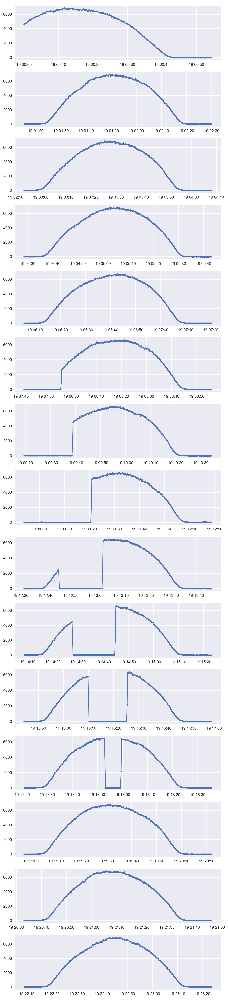

In [88]:
## April 19th 
all_orbits = orbits_finder(df_419)
# Trying to generate all orbit Subplots for a Specific Day
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14, ax15) = plt.subplots(nrows=15, ncols=1, figsize = (8,35))
plt.subplots_adjust(hspace=0.5)
fig.tight_layout()
#fig.suptitle("March 22nd, 2020", fontsize=18, y=0.95)

ax1.plot(single_orb(all_orbits,0)[0],single_orb(all_orbits,0)[1], marker = '.')
ax2.plot(single_orb(all_orbits,1)[0],single_orb(all_orbits,1)[1],marker = '.')
ax3.plot(single_orb(all_orbits,2)[0],single_orb(all_orbits,2)[1],marker = '.')
ax4.plot(single_orb(all_orbits,3)[0],single_orb(all_orbits,3)[1],marker = '.')
ax5.plot(single_orb(all_orbits,4)[0],single_orb(all_orbits,4)[1],marker = '.')
ax6.plot(single_orb(all_orbits,5)[0],single_orb(all_orbits,5)[1],marker = '.')
ax7.plot(single_orb(all_orbits,6)[0],single_orb(all_orbits,6)[1],marker = '.')
ax8.plot(single_orb(all_orbits,7)[0],single_orb(all_orbits,7)[1],marker = '.')
ax9.plot(single_orb(all_orbits,8)[0],single_orb(all_orbits,8)[1],marker = '.')
ax10.plot(single_orb(all_orbits,9)[0],single_orb(all_orbits,9)[1],marker = '.')
ax11.plot(single_orb(all_orbits,10)[0],single_orb(all_orbits,10)[1],marker = '.')
ax12.plot(single_orb(all_orbits,11)[0],single_orb(all_orbits,11)[1],marker = '.')
ax13.plot(single_orb(all_orbits,12)[0],single_orb(all_orbits,12)[1],marker = '.')
ax14.plot(single_orb(all_orbits,13)[0],single_orb(all_orbits,13)[1],marker = '.')
ax15.plot(single_orb(all_orbits,14)[0],single_orb(all_orbits,14)[1],marker = '.')

plt.savefig('Orbits of April 19th')